In [2]:
    pip install pandas

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install imblearn

Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 189 kB 1.4 MB/s            
Note: you may need to restart the kernel to use updated packages.


In [67]:
pip install ml_metrics

Defaulting to user installation because normal site-packages is not writeable
  Preparing metadata (setup.py) ... done
  Created wheel for ml-metrics: filename=ml_metrics-0.1.4-py3-none-any.whl size=7848 sha256=98de476a1387ffbb70d21558cf9842b2b7d6fc823ea9bb388cdb156fde2abab8
  Stored in directory: /home/shatabdi.sen/.cache/pip/wheels/c6/b2/69/0691b3d4de7c8d0c604cd7de94f4b2d4478a04ce3b6e4bab15
Successfully built ml-metrics
Note: you may need to restart the kernel to use updated packages.


In [71]:
pip install seaborn

Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 292 kB 978 kB/s            
Note: you may need to restart the kernel to use updated packages.


In [1]:
# scientific computing libaries
import pandas as pd
import numpy as np

# data mining libaries
from sklearn.tree import DecisionTreeClassifier
from sklearn.feature_selection import RFECV, VarianceThreshold
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.decomposition import PCA#, FastICA
from sklearn.model_selection import train_test_split, KFold, StratifiedKFold, GridSearchCV, learning_curve
from sklearn import svm
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import make_scorer, accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from ml_metrics import quadratic_weighted_kappa
random_state = 42
from sklearn.metrics import roc_curve, auc, confusion_matrix, accuracy_score, f1_score, precision_score, recall_score, roc_auc_score
from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import make_pipeline, Pipeline
from imblearn.over_sampling import SMOTE

#plot libaries
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style(style='darkgrid')
import plotly
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True) # to show plots in notebook

# online plotly
#from plotly.plotly import plot, iplot
#plotly.tools.set_credentials_file(username='XXXXXXXXXXXXXXX', api_key='XXXXXXXXXXXXXXX')

# offline plotly
from plotly.offline import plot, iplot

# do not show any warnings
import warnings
warnings.filterwarnings('ignore')

SEED = 2020 # specify seed for reproducable results
pd.set_option('display.max_columns', None) # prevents abbreviation (with '...') of columns in prints

In [2]:
core = pd.read_csv("All_data.txt",sep='\t')
core.head()

,ID,classical_label,Origin,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF

In [3]:
core = core.drop_duplicates(subset='ID', keep="first")

In [4]:
core.shape

(39756, 14296)

In [5]:
core = core.drop(['Sorghum_v3_1_annotation', 'Tzi8'], axis = 1)

In [6]:
cat_col = ['ID','classical_label','core_label','Origin','Subcel1','Subcel2','Subcel3','Subcel4','Subcel5','Localization','Type','chromosome']
for col in core.columns:
    if col not in cat_col and core[col].dtypes == 'object':
        core[col] = core[col].replace('None', np.nan)
        core[col] = core[col].replace('none', np.nan)
        core[col] = core[col].replace('NA16', np.nan)
        core[col] = core[col].replace('#VALUE!', np.nan)
        core[col] = core[col].astype(float)
core.dtypes

ID                                        object
classical_label                           object
Origin                                    object
core_label                                object
DCC_Twist_Tilt_lag_1                     float64
                                          ...   
variants_effect_stop_gained              float64
variants_effect_stop_lost                float64
variants_effect_stop_retained_variant    float64
variants_effect_synonymous_variant       float64
variants_effect_upstream_gene_variant    float64
Length: 14294, dtype: object

In [103]:
feature = pd.read_csv("top_25_features.txt",sep='\t',header=None)
feature.head()

,0
0,ka_div_ks_plus1_x
1,EREB_138
2,Total_PFAM_x
3,ka_div_ks_plus1_y
4,Origin_Tandem


In [109]:
my_list = list(feature[0])
my_list.remove("Origin_Tandem")
my_list.remove("chrom_chr10")
my_list.append("ID")
my_list.append("Origin")
my_list.append("chromosome")
my_list.append("core_label")
Core_range = core[my_list]
Core_range = Core_range.replace(np.nan,0)
for col in Core_range.columns:
    print(col,min(Core_range[col]),max(Core_range[col]))


ka_div_ks_plus1_x 0.0 100.0060523
EREB_138 0 9
Total_PFAM_x 0 1
ka_div_ks_plus1_y 0.0 307.25
Ear_E6_Repression/Activation 0 6
dTSS_root 0 14
dis_to_Knob 0 237017383
Ks_B73_vs_sorghum 0.0 157.730316
V5_TE 0 295
UTR3length 0 8154
TC_WDR 0.0 0.0181818181818182
TC_HEN 0.0 0.0147058823529412
TC_WAA 0.0 0.0208333333333333
SNPS 0 9592
1kb_EREB_29 0 6
TC_GRR 0.0 0.0384615384615385
dTSS_shoot 0 16
gene_breadth 0 171
dis_to_cen 0 170670191
Leaf_E1_Activation 0 4
1kb_ARF_34 0 5
1kb_EREB_138 0 6
LBD19 0 13
ID Zm00001eb000010 Zm00001eb443030
Origin Both WGD
chromosome chr1 scaf_94
core_label Core Gene Private Gene


In [9]:
Extra_test = core[core['core_label'] == 'None']
Extra_test.head()

,ID,classical_label,Origin,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF

In [10]:
Extra_test.shape

(874, 14294)

In [56]:
my_list = list(feature_list[0])
my_list.remove("Origin_Tandem")
my_list.remove("chrom_chr10")
my_list.append("ID")
my_list.append("Origin")
my_list.append("chromosome")
my_list.append("core_label")
Extra_test_new = Extra_test[my_list]
Extra_test_new.head(20)

,ka_div_ks_plus1_x,EREB_138,Total_PFAM_x,ka_div_ks_plus1_y,Ear_E6_Repression/Activation,dTSS_root,dis_to_Knob,Ks_B73_vs_sorghum,V5_TE,UTR3length,TC_WDR,TC_HEN,TC_WAA,SNPS,1kb_EREB_29,TC_GRR,dTSS_shoot,gene_breadth,dis_to_cen,Leaf_E1_Activation,1kb_ARF_34,1kb_EREB_138,LBD19,ID,Origin,chromosome,core_label
4543,NaN,0,0,NaN,0,0,39027891,NaN,0,0,0.0,0.000000,0.0,0,0,0.000000,0,18,96970958,0,0,0,0,Zm00001eb045160,Tandem,chr1,None
4544,NaN,1,0,NaN,1,0,39021956,NaN,1,0,0.0,0.000000,0.0,4,2,0.005988,0,19,96976892,0,1,1,0,Zm00001eb045170,Both,chr1,None
4545,NaN,1,0,NaN,0,0,39016000,NaN,0,0,0.0,0.000000,0.0,11,1,0.006024,0,29,96982848,0,2,1,1,Zm00001eb045180,Tandem,chr1,None
6913,NaN,0,1,NaN,1,1,26876467,NaN,3,248,0.0,0.000000,0.0,81,0,0.002618,0,88,89381751,0,2,0,0,Zm00001eb069400,None,chr2,None
6914,NaN,4,1,NaN,1,1,26871062,NaN,1,374,0.0,0.001203,0.0,124,1,0.000000,0,113,89376346,0,1,1,3,Zm00001eb069410,None,chr2,None
6916,NaN,2,1,NaN,0,0,26851214,NaN,0,450,0.0,0.000000,0.0,63,0,0.000000,0,157,89356498,0,0,0,1,Zm00001eb069440,None,chr2,None
6918,NaN,2,1,NaN,0,0,26844562,NaN,0,249,0.0,0.000000,0.0,107,2,0.000000,0,166,89349846,1,1,2,0,Zm00001eb069460,Both,chr2,None
6920,NaN,3,1,NaN,1,0,26769138,NaN,2,720,0.0,0.000000,0.0,331,0,0.000000,0,57,89274422,0,0,0,3,Zm00001eb069480,WGD,chr2,None
6921,NaN,1,1,1.234575,0,0,26717105,NaN,0,256,0.0,0.000000,0.0,240,0,0.000000,0,165,89222389,1,0,0,0,Zm00001eb069490,WGD,chr2,None
6924,NaN,0,1,NaN,0,0,26670835,NaN,0,177,0.0,0.000000,0.0,95,0,0.000000,0,170,89176119,0,1,0,0,Zm00001eb069520,None,chr2,None


In [7]:
core = core[core['core_label'] != 'None']
core.shape

(38882, 14294)

In [8]:
for ele in core['core_label']:
    if ele != 'Core Gene':
        core['core_label'] = core['core_label'].replace(ele,'Non-Core Gene')
core.head()

,ID,classical_label,Origin,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF

In [9]:
classes=core['core_label'].value_counts()
Gene_NonCore=round(classes['Non-Core Gene']/core['core_label'].count()*100,2)
Gene_Core=round(classes['Core Gene']/core['core_label'].count()*100, 2)
print("Non-Core : {} %".format(Gene_NonCore))
print("    Core : {} %".format(Gene_Core))

Non-Core : 27.63 %
    Core : 72.37 %


In [10]:
for col in cat_col:
    core[col] = core[col].replace('None', "Unknown")
    print(col,core[col].isnull().sum())

ID 0
classical_label 0
core_label 0
Origin 0
Subcel1 0
Subcel2 0
Subcel3 0
Subcel4 0
Subcel5 0
Localization 0
Type 0
chromosome 0


In [11]:
core['classical_label'] = core['classical_label'].replace("Unknown",'Others')
core['classical_label'] = core['classical_label'].replace("1",'Classical')

In [12]:
num_col = [ele for ele in core.columns if ele not in cat_col]
len(num_col)

14282

In [13]:
core_mis = core
del core
# core_mis = core_mis.fillna(0)
core_mis.head()

,ID,classical_label,Origin,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF

In [36]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state = 42)
X_ovr = core_mis.drop('core_label', axis=1) 
X_ovr['Origin'] = X_ovr['Origin'].replace("Unknown",3)
X_ovr['Origin'] = X_ovr['Origin'].replace("WGD",1)
X_ovr['Origin'] = X_ovr['Origin'].replace("Tandem",2)
X_ovr['Origin'] = X_ovr['Origin'].replace("Both",2)
for col in cat_col:
    if col == 'core_label' or col == 'Origin':
        continue
    else:
        X_ovr[col] = pd.to_numeric(X_ovr[col], errors='coerce')
X_ovr = X_ovr.fillna(0)
if "ID" in X_ovr.columns:
    X_ovr = X_ovr.drop("ID", axis=1)
y_ovr = core_mis['core_label']
X_oversampled, Y_oversampled = sm.fit_resample(X_ovr,y_ovr)
X_smote = pd.DataFrame(X_oversampled, columns=X_ovr.columns)

In [37]:
X_smote['core_label'] = Y_oversampled
X_smote= X_smote[X_smote['Origin'] != 3]
print(X_smote.core_label.value_counts())

Core Gene        11361
Non-Core Gene     5324
Name: core_label, dtype: int64


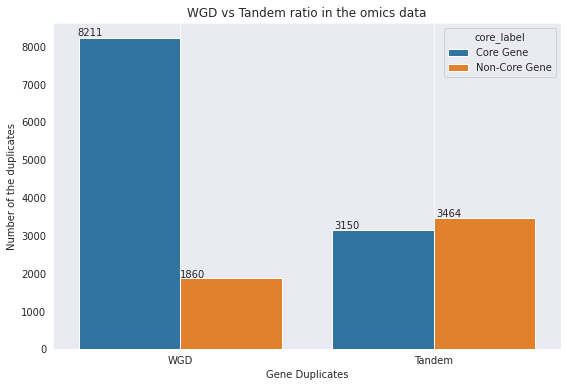

In [40]:
X_smote['Origin'] = X_smote['Origin'].replace(1,"WGD")
X_smote['Origin'] = X_smote['Origin'].replace(2,"Tandem")
plt.figure(figsize=(20,6))

plt.subplot(1,2,1)
ax=sns.countplot(X_smote["Origin"],hue=X_smote["core_label"])
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x() * 1.01 , p.get_height() * 1.01))
plt.ylabel("Number of the duplicates")
plt.xlabel("Gene Duplicates")
plt.title("WGD vs Tandem ratio in the omics data")
plt.grid()
plt.savefig("Ratio_WGD_Tandem.png")

In [18]:
classical_label = pd.get_dummies(core_mis['classical_label'], prefix= 'class')
Origin = pd.get_dummies(core_mis['Origin'], prefix= 'Origin')
Subcel1 = pd.get_dummies(core_mis['Subcel1'], drop_first=True, prefix= 'Subcel1')
Subcel2 = pd.get_dummies(core_mis['Subcel2'], drop_first=True, prefix= 'Subcel2')
Subcel3 = pd.get_dummies(core_mis['Subcel1'], drop_first=True, prefix= 'Subcel3')
Subcel4 = pd.get_dummies(core_mis['Subcel2'], drop_first=True, prefix= 'Subcel4')
Subcel5 = pd.get_dummies(core_mis['Subcel1'], drop_first=True, prefix= 'Subcel5')
Localization = pd.get_dummies(core_mis['Localization'], drop_first=True, prefix= 'Localization')
Type = pd.get_dummies(core_mis['Type'], drop_first=True, prefix= 'Type')
chromosome = pd.get_dummies(core_mis['chromosome'], drop_first=True, prefix= 'chrom')

core_2 = pd.concat([core_mis,classical_label,Origin,Subcel1,Subcel2,Subcel3,Subcel4,Subcel5,Localization,Type,chromosome],axis=1)

core_2 = core_2.drop(['ID','classical_label','Origin','Subcel1','Subcel2','Subcel3','Subcel4','Subcel5','Localization','Type','chromosome'],1)

In [19]:
core_2['core_label'] = core_2['core_label'].replace('Non-Core Gene',0)
core_2['core_label'] = core_2['core_label'].replace('Core Gene',1)

In [20]:
del core_mis
core_2.head()

,core_label,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF_35,1kb_ARF_36,1kb_ARF_39,

In [21]:
X = core_2.drop('core_label', axis=1)  
y = core_2['core_label'] 
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state = 2020, stratify=y)

In [22]:
X_train = X_train.dropna(axis=1, thresh=0.8) #drop the columns with missing rate > 80%
print(X_train.shape)
# print(X_train2.shape) 

(31105, 14405)


In [23]:
X_test = X_test.dropna(axis=1, thresh=0.8) #drop the columns with missing rate > 80%
print(X_test.shape)

(7777, 14405)


In [25]:
X_train = X_train.fillna(0)
ss = StandardScaler()
num_col.remove('L4_preligule')
num_col.remove('lg1_3_lg1_R_mutant')
X_train[num_col] = ss.fit_transform(X_train[num_col])

In [26]:
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X_train, y_train)

In [27]:
print(X_res.shape)

(45020, 14405)


In [22]:

selector = VarianceThreshold(0.01)
# num_col.remove('L4_preligule')
# num_col.remove('lg1_3_lg1_R_mutant')
# X_train_num = X_train[num_col]
# X_train_num.shape
selector.fit(X_res[num_col])
high_var_X_train_col = X_res.columns[selector.get_support(indices=True)]
print(len(high_var_X_train_col))
print(X_res.shape)
# for col in high_var_X_train_col:
#     if col in cat_col:
#         print("its categorical")

col_to_drop = []
for col in num_col:
    if col not in high_var_X_train_col:
        col_to_drop.append(col)
#         X_train.drop(col,axis=1)
print(len(col_to_drop))
print('number of columns after dropping by variance threshold:', X_res.shape[1])

13994
(45020, 14405)
286
number of columns after dropping by variance threshold: 14405


In [23]:
# print(col_to_drop)
X_res = X_res.drop(col_to_drop, axis = 1)
print('number of columns after dropping by variance threshold:', X_res.shape[1])

number of columns after dropping by variance threshold: 14119


In [28]:
# Threshold for removing correlated variables
threshold = 0.8

# Absolute value correlation matrix
corr_matrix = X_res.corr().abs()
corr_matrix.head()


,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF_35,1kb_ARF_36,1kb_ARF_39,1kb_ARF_4,1

In [29]:
# Upper triangle of correlations
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
upper.head()

,DCC_Twist_Tilt_lag_1,DCC_Twist_Tilt_lag_2,DCC_Tilt_Twist_lag_1,DCC_Tilt_Twist_lag_2,DACC_Twist_lag1,DACC_Twist_lag2,DACC_Tilt_lag1,DACC_Tilt_lag2,DACC_Twist_Tilt_lag_1,DACC_Twist_Tilt_lag_2,DACC_Tilt_Twist_lag_1,DACC_Tilt_Twist_lag_2,TCC_Dnase_I_Nucleosome_lag_1,TCC_Dnase_I_Nucleosome_lag_2,TCC_Nucleosome_Dnase_I_lag_1,TCC_Nucleosome_Dnase_I_lag_2,TACC_Dnase_I_lag1,TACC_Dnase_I_lag2,TACC_Nucleosome_lag1,TACC_Nucleosome_lag2,TACC_Dnase_I_Nucleosome_lag_1,TACC_Dnase_I_Nucleosome_lag_2,TACC_Nucleosome_Dnase_I_lag_1,TACC_Nucleosome_Dnase_I_lag_2,PseDNC_Xc1_AA,PseDNC_Xc1_AC,PseDNC_Xc1_AG,PseDNC_Xc1_AT,PseDNC_Xc1_CA,PseDNC_Xc1_CC,PseDNC_Xc1_CG,PseDNC_Xc1_CT,PseDNC_Xc1_GA,PseDNC_Xc1_GC,PseDNC_Xc1_GG,PseDNC_Xc1_GT,PseDNC_Xc1_TA,PseDNC_Xc1_TC,PseDNC_Xc1_TG,PseDNC_Xc1_TT,PseDNC_Xc2_lambda_1,PseDNC_Xc2_lambda_2,PseDNC_Xc2_lambda_3,PseKNC_3_Xc1_AAA,PseKNC_3_Xc1_AAC,PseKNC_3_Xc1_AAG,PseKNC_3_Xc1_AAT,PseKNC_3_Xc1_ACA,PseKNC_3_Xc1_ACC,PseKNC_3_Xc1_ACG,PseKNC_3_Xc1_ACT,PseKNC_3_Xc1_AGA,PseKNC_3_Xc1_AGC,PseKNC_3_Xc1_AGG,PseKNC_3_Xc1_AGT,PseKNC_3_Xc1_ATA,PseKNC_3_Xc1_ATC,PseKNC_3_Xc1_ATG,PseKNC_3_Xc1_ATT,PseKNC_3_Xc1_CAA,PseKNC_3_Xc1_CAC,PseKNC_3_Xc1_CAG,PseKNC_3_Xc1_CAT,PseKNC_3_Xc1_CCA,PseKNC_3_Xc1_CCC,PseKNC_3_Xc1_CCG,PseKNC_3_Xc1_CCT,PseKNC_3_Xc1_CGA,PseKNC_3_Xc1_CGC,PseKNC_3_Xc1_CGG,PseKNC_3_Xc1_CGT,PseKNC_3_Xc1_CTA,PseKNC_3_Xc1_CTC,PseKNC_3_Xc1_CTG,PseKNC_3_Xc1_CTT,PseKNC_3_Xc1_GAA,PseKNC_3_Xc1_GAC,PseKNC_3_Xc1_GAG,PseKNC_3_Xc1_GAT,PseKNC_3_Xc1_GCA,PseKNC_3_Xc1_GCC,PseKNC_3_Xc1_GCG,PseKNC_3_Xc1_GCT,PseKNC_3_Xc1_GGA,PseKNC_3_Xc1_GGC,PseKNC_3_Xc1_GGG,PseKNC_3_Xc1_GGT,PseKNC_3_Xc1_GTA,PseKNC_3_Xc1_GTC,PseKNC_3_Xc1_GTG,PseKNC_3_Xc1_GTT,PseKNC_3_Xc1_TAA,PseKNC_3_Xc1_TAC,PseKNC_3_Xc1_TAG,PseKNC_3_Xc1_TAT,PseKNC_3_Xc1_TCA,PseKNC_3_Xc1_TCC,PseKNC_3_Xc1_TCG,PseKNC_3_Xc1_TCT,PseKNC_3_Xc1_TGA,PseKNC_3_Xc1_TGC,PseKNC_3_Xc1_TGG,PseKNC_3_Xc1_TGT,PseKNC_3_Xc1_TTA,PseKNC_3_Xc1_TTC,PseKNC_3_Xc1_TTG,PseKNC_3_Xc1_TTT,PseKNC_3_Xc2_lambda_1,PseKNC_3_Xc2_lambda_2,PseKNC_3_Xc2_lambda_3,PseKNC_5_Xc1_AAA,PseKNC_5_Xc1_AAC,PseKNC_5_Xc1_AAG,PseKNC_5_Xc1_AAT,PseKNC_5_Xc1_ACA,PseKNC_5_Xc1_ACC,PseKNC_5_Xc1_ACG,PseKNC_5_Xc1_ACT,PseKNC_5_Xc1_AGA,PseKNC_5_Xc1_AGC,PseKNC_5_Xc1_AGG,PseKNC_5_Xc1_AGT,PseKNC_5_Xc1_ATA,PseKNC_5_Xc1_ATC,PseKNC_5_Xc1_ATG,PseKNC_5_Xc1_ATT,PseKNC_5_Xc1_CAA,PseKNC_5_Xc1_CAC,PseKNC_5_Xc1_CAG,PseKNC_5_Xc1_CAT,PseKNC_5_Xc1_CCA,PseKNC_5_Xc1_CCC,PseKNC_5_Xc1_CCG,PseKNC_5_Xc1_CCT,PseKNC_5_Xc1_CGA,PseKNC_5_Xc1_CGC,PseKNC_5_Xc1_CGG,PseKNC_5_Xc1_CGT,PseKNC_5_Xc1_CTA,PseKNC_5_Xc1_CTC,PseKNC_5_Xc1_CTG,PseKNC_5_Xc1_CTT,PseKNC_5_Xc1_GAA,PseKNC_5_Xc1_GAC,PseKNC_5_Xc1_GAG,PseKNC_5_Xc1_GAT,PseKNC_5_Xc1_GCA,PseKNC_5_Xc1_GCC,PseKNC_5_Xc1_GCG,PseKNC_5_Xc1_GCT,PseKNC_5_Xc1_GGA,PseKNC_5_Xc1_GGC,PseKNC_5_Xc1_GGG,PseKNC_5_Xc1_GGT,PseKNC_5_Xc1_GTA,PseKNC_5_Xc1_GTC,PseKNC_5_Xc1_GTG,PseKNC_5_Xc1_GTT,PseKNC_5_Xc1_TAA,PseKNC_5_Xc1_TAC,PseKNC_5_Xc1_TAG,PseKNC_5_Xc1_TAT,PseKNC_5_Xc1_TCA,PseKNC_5_Xc1_TCC,PseKNC_5_Xc1_TCG,PseKNC_5_Xc1_TCT,PseKNC_5_Xc1_TGA,PseKNC_5_Xc1_TGC,PseKNC_5_Xc1_TGG,PseKNC_5_Xc1_TGT,PseKNC_5_Xc1_TTA,PseKNC_5_Xc1_TTC,PseKNC_5_Xc1_TTG,PseKNC_5_Xc1_TTT,PseKNC_5_Xc2_lambda_1,PseKNC_5_Xc2_lambda_2,PseKNC_5_Xc2_lambda_3,PseKNC_5_Xc2_lambda_4,PseKNC_5_Xc2_lambda_5,Ear_(E2+E3+E4+E5+E8)_Activation,Ear_(E1+E9)low_signal,Ear_E6_Repression/Activation,Ear_E7_Repression,Leaf_E5_Activation,Leaf_E4_Activation,Leaf_(E2+E8+E9)_Activation,Leaf_E1_Activation,Leaf_E11_Activation,Leaf_E3_Activation,Leaf_E10_Activation,Leaf_E7_Low_signal,Leaf_E6_Repression,acds,ARF_10,ARF_13,ARF_14,ARF_16,ARF_18,ARF_25,ARF_27,ARF_29,ARF_34,ARF_35,ARF_36,ARF_39,ARF_4,ARF_7,BAD_1,BZIP_25,BZIP_54,BZIP_57,BZIP_72,BZIP_96,atac_ear,atac_leaf,B73_UniformMu_withW22,dTSS_root,dTSS_shoot,Enhancer_Husk,Enhancer_Seedling,V5_TE,EREB71,EREB_127,EREB_138,EREB_29,LBD19,LBD38,LBD5,SBP30,SBP6,SBP8,strand_KN1_ear_summit,strand_TB1_rep1_summit,strand_TB1_rep2_summit,acds_1kb,1kb_ARF_10,1kb_ARF_13,1kb_ARF_14,1kb_ARF_16,1kb_ARF_18,1kb_ARF_25,1kb_ARF_27,1kb_ARF_29,1kb_ARF_34,1kb_ARF_35,1kb_ARF_36,1kb_ARF_39,1kb_ARF_4,1

In [30]:
# Select columns with correlations above threshold
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are %d columns to remove.' % (len(to_drop)))

There are 1105 columns to remove.


In [31]:
corr_drop = open("corr_drop.txt","w")
for ele in to_drop:
    corr_drop.write(ele + "\n")
train = X_res.drop(columns = to_drop)
print('Training shape: ', train.shape)

Training shape:  (45020, 13300)


In [41]:
# from sklearn.linear_model import Lasso, LogisticRegression
# from sklearn.feature_selection import SelectFromModel
# sel_ = SelectFromModel(LogisticRegression(C=1, penalty='l1',solver='liblinear'))
# sel_.fit(train, y_res)

SelectFromModel(estimator=LogisticRegression(C=1, penalty='l1',
                                             solver='liblinear'))

In [42]:
# selected_feat = train.columns[(sel_.get_support())]
# print('total features: {}'.format((train.shape[1])))
# print('selected features: {}'.format(len(selected_feat)))
# print('features with coefficients shrank to zero: {}'.format(
#       np.sum(sel_.estimator_.coef_ == 0)))

total features: 13207
selected features: 9037
features with coefficients shrank to zero: 4169


In [51]:
param = {'C': [10**-2,10**-1,10**0,10**1,10**2]}
lr_model = LogisticRegression(penalty='l1', solver='saga',random_state=random_state)
gs_model = GridSearchCV(estimator=lr_model,param_grid=param)
gs_model.fit(train,y_res)

GridSearchCV(estimator=LogisticRegression(penalty='l1', random_state=42,
                                          solver='saga'),
             param_grid={'C': [0.01, 0.1, 1, 10, 100]})

In [52]:
gs_model.best_params_

{'C': 0.1}

In [53]:
print("It ended")

It ended


In [32]:
from sklearn.ensemble import GradientBoostingClassifier
X_model, X_valid, y_model, y_valid = train_test_split(train, y_res, stratify=y_res, random_state=random_state, test_size=.2)

model_dict = {'LogisticRegression': LogisticRegression(C=0.1,penalty='l1',solver='saga',random_state=random_state)
             , 'ExtraTreesClassifier': ExtraTreesClassifier(n_estimators=200, n_jobs=-1, random_state=random_state)
              , 'RandomForestClassifier': RandomForestClassifier(random_state=random_state, n_jobs=-1)
              , 'GradientBoostingClassifier' : GradientBoostingClassifier(random_state=random_state)
             }
estimator_dict = {}
importance_fatures_sorted_all = pd.DataFrame()
for model_name, model in model_dict.items():
    print('='*10, model_name, '='*10)
    model.fit(X_model, y_model)
    print('Accuracy in training:', accuracy_score(model.predict(X_model), y_model))
    print('Accuracy in valid:', accuracy_score(model.predict(X_valid), y_valid))
    importance_values = np.absolute(model.coef_) if model_name == 'LogisticRegression' else model.feature_importances_
    importance_fatures_sorted = pd.DataFrame(importance_values.reshape([-1, len(train.columns)]), columns=train.columns).mean(axis=0).sort_values(ascending=False).to_frame()
    importance_fatures_sorted.rename(columns={0: 'feature_importance'}, inplace=True)
    importance_fatures_sorted['ranking']= importance_fatures_sorted['feature_importance'].rank(ascending=False)
    importance_fatures_sorted['model'] = model_name
    print('Show top 10 important features:')
    display(importance_fatures_sorted.drop('model', axis=1).head(50))
    importance_fatures_sorted_all = importance_fatures_sorted_all.append(importance_fatures_sorted)
    estimator_dict[model_name] = model

========== LogisticRegression ==========
Accuracy in training: 0.9718180808529543
Accuracy in valid: 0.8837183474011551
Show top 10 important features:


,feature_importance,ranking
ka_div_ks_plus1_x,0.580944,1.0
Origin_WGD,0.463036,2.0
Type_Soluble,0.438378,3.0
Origin_Tandem,0.409811,4.0
dis_to_Knob,0.386991,5.0
CHG_pct_upstream_ZmMC,0.360270,6.0
Subcel1_nucl,0.337165,7.0
Subcel1_chlo,0.330900,8.0
Localization_Nucleus,0.294601,9.0
chrom_chr4,0.287620,10.0


========== ExtraTreesClassifier ==========
Accuracy in training: 1.0
Accuracy in valid: 0.9263660595290982
Show top 10 important features:


,feature_importance,ranking
Origin_WGD,0.015548,1.0
ka_div_ks_plus1_x,0.009674,2.0
EREB_138,0.007995,3.0
protein_breadth,0.007956,4.0
gene_breadth,0.007943,5.0
Total_PFAM_x,0.007896,6.0
LBD19,0.006889,7.0
1kb_EREB_138,0.006458,8.0
1kb_LBD19,0.004840,9.0
EREB_29,0.004360,10.0


========== RandomForestClassifier ==========
Accuracy in training: 1.0
Accuracy in valid: 0.9139271434917814
Show top 10 important features:


,feature_importance,ranking
Kn_B73_vs_sorghum,0.014850,1.0
ka_div_ks_plus1_x,0.012998,2.0
Ks_B73_vs_sorghum,0.011781,3.0
EREB_138,0.011089,4.0
Total_PFAM_x,0.010075,5.0
EREB_29,0.009621,6.0
ka_div_ks_plus1_y,0.009334,7.0
DifferentiationZone_3d,0.007717,8.0
1kb_EREB_138,0.007042,9.0
1kb_EREB71,0.006631,10.0


========== GradientBoostingClassifier ==========
Accuracy in training: 0.9269491337183474
Accuracy in valid: 0.920812972012439
Show top 10 important features:


,feature_importance,ranking
ka_div_ks_plus1_x,0.443842,1.0
EREB_138,0.069332,2.0
Total_PFAM_x,0.053220,3.0
ka_div_ks_plus1_y,0.043460,4.0
Origin_Tandem,0.040808,5.0
dTSS_root,0.032719,6.0
Ear_E6_Repression/Activation,0.031894,7.0
dis_to_Knob,0.021484,8.0
V5_TE,0.017239,9.0
Ks_B73_vs_sorghum,0.017078,10.0


In [33]:
importance_fatures_sorted_all = importance_fatures_sorted_all.loc[:,~importance_fatures_sorted_all.columns.duplicated()]

In [34]:
importance_fatures_sorted_all.head()

,feature_importance,ranking,model
ka_div_ks_plus1_x,0.580944,1.0,LogisticRegression
Origin_WGD,0.463036,2.0,LogisticRegression
Type_Soluble,0.438378,3.0,LogisticRegression
Origin_Tandem,0.409811,4.0,LogisticRegression
dis_to_Knob,0.386991,5.0,LogisticRegression


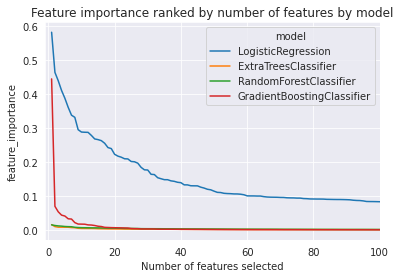

In [38]:
features_df = importance_fatures_sorted_all.copy()
features_df.reset_index(drop=True, inplace=True)
plt.title('Feature importance ranked by number of features by model')
sns.lineplot(x=features_df['ranking'], y=features_df['feature_importance'], hue=features_df['model'])
plt.xlim(-1,100)
plt.xlabel("Number of features selected")
plt.savefig('Advanced_Feature_rank_by_model.png')

In [36]:
selected_model = 'GradientBoostingClassifier'
number_of_features = 40
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()

CPU times: user 209 ms, sys: 171 ms, total: 380 ms
Wall time: 180 ms


<function matplotlib.pyplot.show(close=None, block=None)>

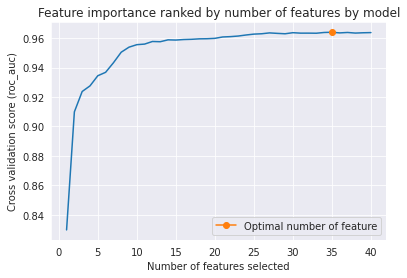

In [40]:
%%time
#it takes much more time comparing to the feature selelction by model
rfecv = RFECV(estimator=model_dict['GradientBoostingClassifier'], step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)
rfecv.fit(train[selected_features_by_model], y_res)
plt.figure()
plt.title('Feature importance ranked by number of features by model')
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score (roc_auc)")
plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_)
plt.plot(rfecv.n_features_, rfecv.grid_scores_[rfecv.n_features_-1], marker='o', label='Optimal number of feature')
plt.legend(loc='best')
plt.savefig('Advanced_Feature_rank_by_num_of_fea_model.png')
plt.show

In [33]:
selected_model = 'LogisticRegression'
number_of_features = 40
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()
# Init/fit
rfecv = RFECV(
    estimator=LogisticRegression(C=0.1,penalty='l1',solver='saga',random_state=random_state), step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)


_ = rfecv.fit(train[selected_features_by_model], y_res)
lasso_mask = rfecv.support_
lasso_mask
lasso_fea = train[selected_features_by_model]
lasso_fea = lasso_fea[lasso_fea.columns[lasso_mask]]
# rfecv.estimator_.coef_
lasso_fea.columns

Index(['ka_div_ks_plus1_x', 'Origin_WGD', 'Type_Soluble', 'Origin_Tandem',
       'dis_to_Knob', 'CHG_pct_upstream_ZmMC', 'Subcel1_nucl', 'Subcel1_chlo',
       'Localization_Nucleus', 'chrom_chr4', 'Localization_Cytoplasm',
       'Leaf_E1_Activation', 'Subcel2_chlo', 'protein_breadth', 'Subcel1_cyto',
       'Total_PFAM_x', 'chrom_chr7', 'Subcel2_mito', 'Subcel2_cyto', 'SNPS',
       'Subcel2_nucl', 'chrom_chr8', 'chrom_chr3', 'Subcel2_none',
       'dis_to_cen', 'Localization_Mitochondrion', 'isoforms', 'chrom_chr6',
       'Ear_(E2+E3+E4+E5+E8)_Activation', 'chrom_chr2', 'Localization_Plastid',
       'Leaf_(E2+E8+E9)_Activation', 'kmer_2_CC_x', 'gene_breadth',
       'chrom_chr5', 'B73_UniformMu_withW22', 'Leaf_E5_Activation',
       'dis_to_telo', 'UTR3length', 'Anthers_R1'],
      dtype='object')

In [34]:
selected_model = 'ExtraTreesClassifier'
number_of_features = 40
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()
rfecv = RFECV(
    estimator=ExtraTreesClassifier(n_estimators=200, n_jobs=-1, random_state=random_state), step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)


_ = rfecv.fit(train[selected_features_by_model], y_res)
ExtraTree_mask = rfecv.support_
ExtraTree_mask
ExtraTree_fea = train[selected_features_by_model]
ExtraTree_fea = ExtraTree_fea[ExtraTree_fea.columns[ExtraTree_mask]]

ExtraTree_fea.columns

Index(['Origin_WGD', 'ka_div_ks_plus1_x', 'EREB_138', 'protein_breadth',
       'gene_breadth', 'Total_PFAM_x', 'LBD19', '1kb_EREB_138', '1kb_LBD19',
       'EREB_29', 'Origin_Unknown', 'dTSS_root', 'dTSS_shoot', '5kb_EREB_138',
       'Leaf_E1_Activation', 'cov_genebody_ZmMC_H3K4me3', 'gene_age', 'EREB71',
       'isoforms', 'atac_ear', '1kb_EREB_29', '1kb_atac_leaf', '1kb_atac_ear',
       'atac_leaf', '5kb_EREB_29', 'Ear_E6_Repression/Activation',
       'Leaf_E5_Activation', 'UTR3length', '5kb_dTSS_shoot', '5kb_atac_leaf',
       'WGCNA_Module6', 'ARF_27', '1kb_EREB71', 'CTriad_VS111',
       'B73_UniformMu_withW22', '5kb_atac_ear',
       'upstream_ATAC_intensity_ZmMC'],
      dtype='object')

In [35]:
selected_model = 'RandomForestClassifier'
number_of_features = 40
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()

rfecv = RFECV(
    estimator=RandomForestClassifier(random_state=random_state,n_jobs=-1), step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)


_ = rfecv.fit(train[selected_features_by_model], y_res)
rf_mask = rfecv.support_
rf_mask
rf_fea = train[selected_features_by_model]
rf_fea = rf_fea[rf_fea.columns[rf_mask]]

rf_fea.columns

Index(['Kn_B73_vs_sorghum', 'ka_div_ks_plus1_x', 'Ks_B73_vs_sorghum',
       'EREB_138', 'Total_PFAM_x', 'EREB_29', 'ka_div_ks_plus1_y',
       'DifferentiationZone_3d', '1kb_EREB_138', 'LBD19', 'dTSS_shoot',
       '5kb_dTSS_shoot', '5kb_EREB_138', 'UTR3length', 'Leaf_E1_Activation',
       'UTR5length', '5kb_LBD19', 'genebody_ATAC_intensity_ZmMC', 'dTSS_root',
       '1kb_EREB_29', '5kb_dTSS_root', 'Ear_E6_Repression/Activation',
       'genebody_his_intensity_ZmMC1_H3K27ac', 'CrownRoot_Node4_V7',
       'avg_gene_abundance', 'gene_breadth', 'Leaf_E4_Activation', 'SNPS',
       'Nonpollinated_leaf_30_DAP', '1kb_atac_leaf', 'V9_Immature_Leaves',
       '5kb_ARF_27', 'Thirteenth_Leaf_R2',
       'upstream_his_intensity_ZmMC1_H3K27ac'],
      dtype='object')

In [36]:
selected_model = 'GradientBoostingClassifier'
number_of_features = 40
selected_features_by_model = importance_fatures_sorted_all[importance_fatures_sorted_all['model'] == selected_model].index[:number_of_features].tolist()

rfecv = RFECV(
    estimator=GradientBoostingClassifier(random_state=random_state), step=1, cv=StratifiedShuffleSplit(1, test_size=.2, random_state=random_state), scoring='roc_auc', n_jobs=-1)


_ = rfecv.fit(train[selected_features_by_model], y_res)
gb_mask = rfecv.support_
gb_mask
gb_fea = train[selected_features_by_model]
gb_fea = gb_fea[gb_fea.columns[gb_mask]]

gb_fea.columns

Index(['ka_div_ks_plus1_x', 'EREB_138', 'Total_PFAM_x', 'ka_div_ks_plus1_y',
       'Origin_Tandem', 'dTSS_root', 'Ear_E6_Repression/Activation',
       'dis_to_Knob', 'V5_TE', 'Ks_B73_vs_sorghum', 'TC_WDR', 'UTR3length',
       'chrom_chr10', 'TC_HEN', 'TC_WAA', '1kb_EREB_138', 'Leaf_E1_Activation',
       'dTSS_shoot', 'gene_breadth', 'SNPS', 'LBD19', '1kb_EREB_29',
       'Leaf_E5_Activation', 'dis_to_cen', '1kb_ARF_34', '1kb_atac_ear',
       'DC_TP', 'Leaf_E3_Activation', 'TC_GRR', 'TC_ASL', 'Origin_Both',
       'Leaf_E4_Activation', '1kb_B73_UniformMu_withW22', 'TC_REL', 'TC_DRH'],
      dtype='object')

In [37]:
set(gb_fea.columns) & set(rf_fea.columns) & set(ExtraTree_fea.columns) & set(lasso_fea.columns)

{'Leaf_E1_Activation',
 'Total_PFAM_x',
 'UTR3length',
 'gene_breadth',
 'ka_div_ks_plus1_x'}

In [44]:
feature_list = list(set(gb_fea.columns) & set(rf_fea.columns) & set(ExtraTree_fea.columns) & set(lasso_fea.columns))
with open('feature_file.txt', 'w') as out_f:
    for l in feature_list:
        out_f.write(l + '\n')

In [45]:
feature_list = list(set(gb_fea.columns) | set(rf_fea.columns) | set(ExtraTree_fea.columns) | set(lasso_fea.columns))
with open('feature_file_union.txt', 'w') as out_f:
    for l in feature_list:
        out_f.write(l + '\n')
print(feature_list)

['dTSS_root', 'Subcel1_cyto', 'UTR3length', 'EREB71', 'LBD19', 'kmer_2_CC_x', 'Subcel2_cyto', '5kb_ARF_27', 'gene_age', 'EREB_29', 'Kn_B73_vs_sorghum', 'TC_WAA', 'dis_to_Knob', 'DifferentiationZone_3d', '5kb_atac_ear', 'chrom_chr6', 'Subcel2_nucl', 'TC_REL', '1kb_EREB_138', 'Thirteenth_Leaf_R2', 'Subcel2_chlo', 'genebody_his_intensity_ZmMC1_H3K27ac', 'TC_GRR', 'CrownRoot_Node4_V7', 'DC_TP', '1kb_LBD19', 'Subcel2_none', 'atac_leaf', 'cov_genebody_ZmMC_H3K4me3', 'ARF_27', 'Type_Soluble', 'dis_to_cen', 'TC_HEN', 'TC_DRH', 'Localization_Nucleus', 'TC_ASL', 'SNPS', 'Origin_Unknown', 'Subcel2_mito', 'Origin_Both', 'Origin_WGD', 'UTR5length', 'Ear_(E2+E3+E4+E5+E8)_Activation', 'ka_div_ks_plus1_y', '1kb_EREB_29', 'Localization_Cytoplasm', '1kb_atac_ear', 'chrom_chr2', '5kb_dTSS_shoot', 'Leaf_E5_Activation', 'CTriad_VS111', '1kb_atac_leaf', '5kb_atac_leaf', 'genebody_ATAC_intensity_ZmMC', '1kb_B73_UniformMu_withW22', 'Total_PFAM_x', 'gene_breadth', 'dis_to_telo', 'Localization_Mitochondrion', '

In [41]:
print(len(feature_list))

98


In [42]:
feature_list = pd.read_csv("feature_file_union.txt",header=None)
len(feature_list[0])

98

In [43]:
X_after_features = X_res[feature_list[0]]
X_after_features.head()

,dTSS_root,Subcel1_cyto,UTR3length,EREB71,LBD19,kmer_2_CC_x,Subcel2_cyto,5kb_ARF_27,gene_age,EREB_29,Kn_B73_vs_sorghum,TC_WAA,dis_to_Knob,DifferentiationZone_3d,5kb_atac_ear,chrom_chr6,Subcel2_nucl,TC_REL,1kb_EREB_138,Thirteenth_Leaf_R2,Subcel2_chlo,genebody_his_intensity_ZmMC1_H3K27ac,TC_GRR,CrownRoot_Node4_V7,DC_TP,1kb_LBD19,Subcel2_none,atac_leaf,cov_genebody_ZmMC_H3K4me3,ARF_27,Type_Soluble,dis_to_cen,TC_HEN,TC_DRH,Localization_Nucleus,TC_ASL,SNPS,Origin_Unknown,Subcel2_mito,Origin_Both,Origin_WGD,UTR5length,Ear_(E2+E3+E4+E5+E8)_Activation,ka_div_ks_plus1_y,1kb_EREB_29,Localization_Cytoplasm,1kb_atac_ear,chrom_chr2,5kb_dTSS_shoot,Leaf_E5_Activation,CTriad_VS111,1kb_atac_leaf,5kb_atac_leaf,genebody_ATAC_intensity_ZmMC,1kb_B73_UniformMu_withW22,Total_PFAM_x,gene_breadth,dis_to_telo,Localization_Mitochondrion,ka_div_ks_plus1_x,Ear_E6_Repression/Activation,Localization_Plastid,5kb_dTSS_root,Nonpollinated_leaf_30_DAP,EREB_138,B73_UniformMu_withW22,5kb_EREB_29,chrom_chr4,Subcel1_chlo,chrom_chr10,upstream_his_intensity_ZmMC1_H3K27ac,protein_breadth,CHG_pct_upstream_ZmMC,Origin_Tandem,WGCNA_Module6,chrom_chr5,chrom_chr7,TC_WDR,Ks_B73_vs_sorghum,V5_TE,Anthers_R1,1kb_ARF_34,upstream_ATAC_intensity_ZmMC,chrom_chr8,isoforms,Subcel1_nucl,chrom_chr3,1kb_EREB71,dTSS_shoot,5kb_LBD19,Leaf_(E2+E8+E9)_Activation,Leaf_E3_Activation,atac_ear,5kb_EREB_138,Leaf_E4_Activation,avg_gene_abundance,V9_Immature_Leaves,Leaf_E1_Activation
0,-0.640954,0,-0.381761,-0.653118,-0.845812,0.316543,0,2.325544,-0.691153,-0.804114,-0.085829,-0.16376,-0.068203,-0.083812,-0.749966,0,0,-0.29826,-0.795828,-0.073618,0,-0.47765,-0.348131,-0.255050,-0.708131,-0.717916,0,-0.649102,-0.457581,2.567035,0,1.311901,-0.09856,-0.127824,0,-0.385564,0.100249,0,0,0,1,-0.659508,-0.357656,-0.145720,-0.692433,0,-0.592218,0,-0.597848,2.840698,-0.713207,-0.616479,-0.760747,-0.530876,-0.494488,0.657286,0.384705,-0.846690,0,0.436489,-0.444004,0,-0.634265,-0.126390,-0.919212,-0.625818,-0.873453,1,0,0,-0.420114,-0.557613,-0.301474,0,-0.361269,0,0,-0.086474,-0.170579,-0.414213,-0.144933,-0.570307,-0.472524,0,3.749454,0,0,-0.555153,-0.59919,-0.887648,-0.372929,1.195377,-0.619021,-0.972342,1.616094,-0.162999,-0.195649,-0.563912
1,-0.640954,1,-0.421637,0.495284,-0.080660,-0.887686,0,-0.845386,2.573639,0.192975,-0.149753,-0.16376,1.823566,-0.087779,-0.749966,0,0,-0.29826,0.376081,-0.096859,1,-0.47765,3.756726,-0.257122,-0.708131,0.308645,0,-0.649102,-0.457581,-0.623807,1,-0.058266,-0.09856,-0.127824,1,-0.385564,-0.563705,1,0,0,0,0.214992,-0.357656,-0.198410,0.672468,0,-0.592218,0,-0.597848,-0.515485,1.007159,-0.616479,-0.760747,-0.530876,-0.494488,-1.521409,-2.046746,-0.306146,0,-0.548832,1.639379,0,-0.634265,-0.139852,-0.058523,-0.625818,-0.112402,1,0,0,-0.420114,-0.557613,-0.368898,0,-0.361269,0,0,-0.086474,-0.186483,-0.414213,-0.143125,-0.570307,-0.472524,0,-0.611458,0,0,0.963050,-0.59919,-0.303006,-0.372929,-0.520698,-0.619021,-0.336562,-0.467924,-0.185791,-0.216123,-0.563912
2,-0.640954,1,-0.953313,-0.653118,-0.845812,-0.887686,0,1.532812,-0.527914,-0.804114,14.920791,-0.16376,-0.691249,-0.086101,-0.749966,0,0,-0.29826,-0.795828,-0.087953,0,-0.47765,-0.348131,-0.257122,-0.708131,0.308645,0,-0.649102,-0.457581,-0.623807,0,0.586877,-0.09856,-0.127824,0,-0.385564,-0.572005,1,0,0,0,-0.856699,-0.357656,-0.157651,-0.692433,0,-0.592218,0,-0.597848,1.162606,-1.788435,-0.616479,-0.760747,-0.530876,-0.494488,0.657286,-1.661912,2.391534,0,0.527605,1.639379,0,-0.634265,-0.139852,-0.919212,-0.625818,-0.112402,0,0,0,-0.420114,-0.557613,-0.368898,0,-0.361269,1,0,-0.086474,2.473384,-0.414213,-0.153882,3.825345,-0.472524,0,-0.611458,0,0,0.963050,-0.59919,-0.303006,-0.372929,-0.520698,-0.619021,-0.336562,-0.467924,-0.182494,-0.216123,-0.563912
3,0.845984,0,0.754698,0.495284,1.449644,1.370243,0,-0.052653,-0.364674,1.190063,-0.099059,-0.16376,-0.569084,-0.072346,0.202846,0,0,-0.29826,-0.795828,-0.072773,0,-0.47765,-0.348131,0.061132,0.297631,0.308645,0,1.865415,-0.457581,0.439807,1,0.305516,-0.09856,-0.127824

In [91]:
# from xgboost.sklearn import XGBClassifier
model = XGBClassifier(random_state=random_state)
gb_fit = model.fit(X_after_features, y_res)

[23:20:15] WARNING: ../src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [92]:
LR_ypred = model.predict(X_test_after_features)

In [44]:
def plot_confusion_matrix(cm, classes, title='Confusion matrix', cmap=plt.cm.Blues):
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(10,10))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.show()

TP:5367, TN:1762, FP:387, FN:261


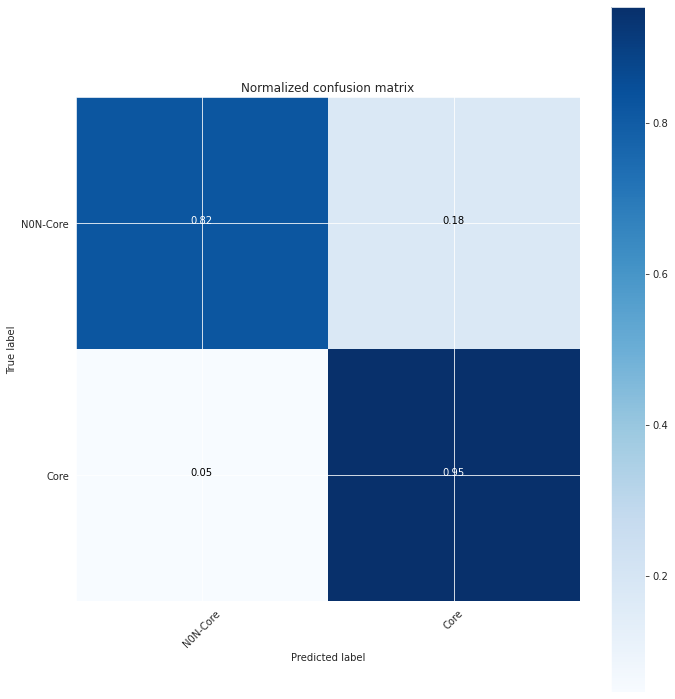

In [94]:
LR_cnf_matrix = confusion_matrix(y_test, LR_ypred)
print("TP:{}, TN:{}, FP:{}, FN:{}".format(LR_cnf_matrix[1][1], LR_cnf_matrix[0][0], LR_cnf_matrix[0][1], LR_cnf_matrix[1][0]))
np.set_printoptions(precision=2)
plot_confusion_matrix(LR_cnf_matrix, classes=["N0N-Core","Core"], title='Normalized confusion matrix')
# LR_dict['False_Positive'] = LR_cnf_matrix[0][1]
# LR_dict['False_Negative'] = LR_cnf_matrix[1][0]

Text(0.5, 0, 'Xgboost Feature Importance')

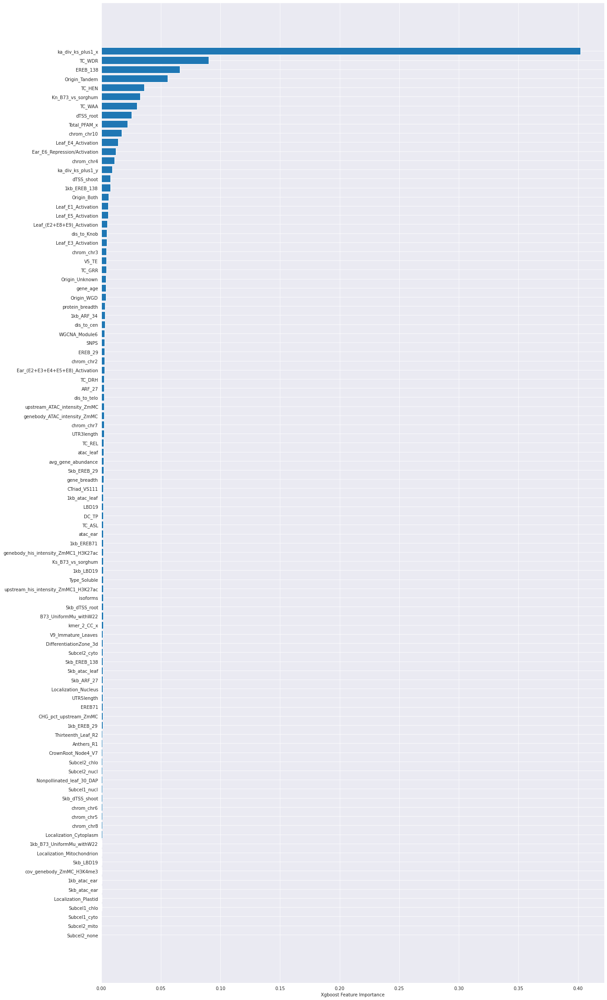

In [72]:
sorted_idx = xgb_fit.feature_importances_.argsort()
plt.figure(figsize=(20,40))
plt.barh(X_after_features.columns[sorted_idx], xgb_fit.feature_importances_[sorted_idx])
plt.xlabel("Xgboost Feature Importance")

In [83]:
X_test[feature_list[0]].head()

,dTSS_root,Subcel1_cyto,UTR3length,EREB71,LBD19,kmer_2_CC_x,Subcel2_cyto,5kb_ARF_27,gene_age,EREB_29,Kn_B73_vs_sorghum,TC_WAA,dis_to_Knob,DifferentiationZone_3d,5kb_atac_ear,chrom_chr6,Subcel2_nucl,TC_REL,1kb_EREB_138,Thirteenth_Leaf_R2,Subcel2_chlo,genebody_his_intensity_ZmMC1_H3K27ac,TC_GRR,CrownRoot_Node4_V7,DC_TP,1kb_LBD19,Subcel2_none,atac_leaf,cov_genebody_ZmMC_H3K4me3,ARF_27,Type_Soluble,dis_to_cen,TC_HEN,TC_DRH,Localization_Nucleus,TC_ASL,SNPS,Origin_Unknown,Subcel2_mito,Origin_Both,Origin_WGD,UTR5length,Ear_(E2+E3+E4+E5+E8)_Activation,ka_div_ks_plus1_y,1kb_EREB_29,Localization_Cytoplasm,1kb_atac_ear,chrom_chr2,5kb_dTSS_shoot,Leaf_E5_Activation,CTriad_VS111,1kb_atac_leaf,5kb_atac_leaf,genebody_ATAC_intensity_ZmMC,1kb_B73_UniformMu_withW22,Total_PFAM_x,gene_breadth,dis_to_telo,Localization_Mitochondrion,ka_div_ks_plus1_x,Ear_E6_Repression/Activation,Localization_Plastid,5kb_dTSS_root,Nonpollinated_leaf_30_DAP,EREB_138,B73_UniformMu_withW22,5kb_EREB_29,chrom_chr4,Subcel1_chlo,chrom_chr10,upstream_his_intensity_ZmMC1_H3K27ac,protein_breadth,CHG_pct_upstream_ZmMC,Origin_Tandem,WGCNA_Module6,chrom_chr5,chrom_chr7,TC_WDR,Ks_B73_vs_sorghum,V5_TE,Anthers_R1,1kb_ARF_34,upstream_ATAC_intensity_ZmMC,chrom_chr8,isoforms,Subcel1_nucl,chrom_chr3,1kb_EREB71,dTSS_shoot,5kb_LBD19,Leaf_(E2+E8+E9)_Activation,Leaf_E3_Activation,atac_ear,5kb_EREB_138,Leaf_E4_Activation,avg_gene_abundance,V9_Immature_Leaves,Leaf_E1_Activation
22354,0,0,0,0,0,98,1,0,1,0,NaN,0.0,1527937,NaN,0,0,0,0.000000,0,NaN,0,NaN,0.000000,NaN,0.003003,0,0,0,NaN,0,1,90370164,0.0,0.0,0,0.003012,0,0,0,1,0,0,0,NaN,0,1,0,0,0,1,1.000000,0,0,NaN,0,1,6,14757968.0,0,NaN,1,0,0,NaN,0,0,0,0,1,0,NaN,0,NaN,0,0,1,0,0.0,NaN,0,NaN,0,NaN,0,1,0,0,0,0,0,0,0,0,0,0,0.004103,NaN,0
1853,1,0,202,1,1,87,1,4,6,0,0.1408,0.0,16711450,64.224733,2,0,0,0.001761,0,NaN,0,0.872739,0.000000,19.914020,0.001757,0,0,1,0.000000,2,1,76511734,0.0,0.0,0,0.003521,258,1,0,0,0,146,0,1.774014,0,1,1,0,1,2,0.375000,0,1,1.270205,0,1,135,49779698.0,0,1.362311,0,0,1,NaN,0,0,0,0,1,0,0.514543,2,0.013377,0,0,0,0,0.0,0.388616,4,0.33148,0,1.531539,0,1,0,0,0,1,1,1,1,3,0,2,6.130571,0.372914,0
26951,0,0,10,0,0,23,1,0,1,0,NaN,0.0,7986360,NaN,0,0,0,0.000000,0,NaN,0,NaN,0.000000,NaN,0.000000,0,0,0,NaN,0,0,113055242,0.0,0.0,0,0.000000,0,1,0,0,0,2,0,NaN,0,0,0,0,0,0,0.285714,0,0,NaN,0,1,0,218183373.0,0,NaN,0,1,0,NaN,0,0,0,0,0,0,NaN,0,NaN,0,0,1,0,0.0,NaN,1,NaN,0,NaN,0,1,1,0,0,0,0,0,0,0,0,0,NaN,NaN,0
6188,0,0,360,0,1,27,0,0,1,1,0.0027,0.0,1581796,2.020280,2,0,1,0.000000,0,50.476500,0,2.311484,0.005556,2.734438,0.000000,0,0,1,0.054073,1,1,161016784,0.0,0.0,0,0.000000,327,0,0,0,1,235,7,1.000000,0,1,1,0,0,0,1.000000,0,0,1.068150,0,1,171,116558582.0,0,1.038235,0,0,0,2.70101,1,1,0,0,1,0,4.650828,3,0.023593,0,0,0,0,0.0,0.070616,12,22.50630,1,13.582017,0,1,0,0,0,0,0,10,1,2,0,0,13.042349,7.533033,1
14759,0,0,0,0,0,130,1,1,1,0,NaN,0.0,179857220,0.100477,0,0,0,0.001499,0,1.040156,0,NaN,0.000000,0.192719,0.001497,0,0,0,NaN,0,1,93468340,0.0,0.0,0,0.000000,39,1,0,0,0,243,0,1.165068,0,1,0,0,0,0,0.666667,0,0,NaN,0,1,148,57283973.0,0,NaN,0,0,0,3.65590,0,0,0,0,0,0,NaN,0,NaN,0,0,0,0,0.0,NaN,1,0.73962,0,NaN,0,2,1,1,0,0,0,0,0,0,0,0,0.694808,0.306444,0


In [45]:
X_test = X_test.fillna(0)
# ss = StandardScaler()
# num_col.remove('L4_preligule')
# num_col.remove('lg1_3_lg1_R_mutant')
X_test[num_col] = ss.transform(X_test[num_col])
X_test_after_features = X_test[feature_list[0]]
X_test_after_features.head()




,dTSS_root,Subcel1_cyto,UTR3length,EREB71,LBD19,kmer_2_CC_x,Subcel2_cyto,5kb_ARF_27,gene_age,EREB_29,Kn_B73_vs_sorghum,TC_WAA,dis_to_Knob,DifferentiationZone_3d,5kb_atac_ear,chrom_chr6,Subcel2_nucl,TC_REL,1kb_EREB_138,Thirteenth_Leaf_R2,Subcel2_chlo,genebody_his_intensity_ZmMC1_H3K27ac,TC_GRR,CrownRoot_Node4_V7,DC_TP,1kb_LBD19,Subcel2_none,atac_leaf,cov_genebody_ZmMC_H3K4me3,ARF_27,Type_Soluble,dis_to_cen,TC_HEN,TC_DRH,Localization_Nucleus,TC_ASL,SNPS,Origin_Unknown,Subcel2_mito,Origin_Both,Origin_WGD,UTR5length,Ear_(E2+E3+E4+E5+E8)_Activation,ka_div_ks_plus1_y,1kb_EREB_29,Localization_Cytoplasm,1kb_atac_ear,chrom_chr2,5kb_dTSS_shoot,Leaf_E5_Activation,CTriad_VS111,1kb_atac_leaf,5kb_atac_leaf,genebody_ATAC_intensity_ZmMC,1kb_B73_UniformMu_withW22,Total_PFAM_x,gene_breadth,dis_to_telo,Localization_Mitochondrion,ka_div_ks_plus1_x,Ear_E6_Repression/Activation,Localization_Plastid,5kb_dTSS_root,Nonpollinated_leaf_30_DAP,EREB_138,B73_UniformMu_withW22,5kb_EREB_29,chrom_chr4,Subcel1_chlo,chrom_chr10,upstream_his_intensity_ZmMC1_H3K27ac,protein_breadth,CHG_pct_upstream_ZmMC,Origin_Tandem,WGCNA_Module6,chrom_chr5,chrom_chr7,TC_WDR,Ks_B73_vs_sorghum,V5_TE,Anthers_R1,1kb_ARF_34,upstream_ATAC_intensity_ZmMC,chrom_chr8,isoforms,Subcel1_nucl,chrom_chr3,1kb_EREB71,dTSS_shoot,5kb_LBD19,Leaf_(E2+E8+E9)_Activation,Leaf_E3_Activation,atac_ear,5kb_EREB_138,Leaf_E4_Activation,avg_gene_abundance,V9_Immature_Leaves,Leaf_E1_Activation
22354,-0.640954,0,-0.953313,-0.653118,-0.845812,0.410624,1,-0.845386,-0.691153,-0.804114,-0.149753,-0.16376,-0.700936,-0.087779,-0.749966,0,0,-0.298260,-0.795828,-0.096859,0,-0.477650,-0.348131,-0.257122,-0.031582,-0.717916,0,-0.649102,-0.457581,-0.623807,1,0.383195,-0.09856,-0.127824,0,1.273768,-0.713095,0,0,1,0,-0.856699,-0.357656,-0.198410,-0.692433,1,-0.592218,0,-0.597848,1.162606,1.007159,-0.616479,-0.760747,-0.530876,-0.494488,0.657286,-2.029254,-0.648171,0,-0.548832,1.639379,0,-0.634265,-0.139852,-0.919212,-0.625818,-0.873453,0,1,0,-0.420114,-0.557613,-0.368898,0,-0.361269,1,0,-0.086474,-0.186483,-0.414213,-0.153882,-0.570307,-0.472524,0,-0.611458,0,0,-0.555153,-0.599190,-0.887648,-0.372929,-0.520698,-0.619021,-0.972342,-0.467924,-0.188629,-0.216123,-0.563912
1853,0.845984,0,-0.282072,0.495284,-0.080660,0.203647,1,2.325544,0.125045,-0.804114,0.024337,-0.16376,-0.416953,0.731845,1.155658,0,0,1.028417,-0.795828,-0.096859,0,-0.286858,-0.348131,0.559406,-0.312189,-0.717916,0,0.608157,-0.457581,1.503421,1,0.016157,-0.09856,-0.127824,0,1.554218,1.428156,1,0,0,0,-0.230831,-0.357656,-0.127283,-0.692433,1,1.263983,0,0.913658,2.840698,-0.740087,-0.616479,0.188318,0.109149,-0.494488,0.657286,0.227273,-0.083212,0,0.490457,-0.444004,0,0.721760,-0.139852,-0.919212,-0.625818,-0.873453,0,1,0,-0.271622,-0.288699,0.692519,0,-0.361269,0,0,-0.086474,-0.151628,0.812346,-0.146933,-0.570307,-0.201543,0,-0.611458,0,0,-0.555153,1.015731,-0.303006,0.128604,1.195377,3.232420,-0.972342,3.700112,-0.065592,-0.205704,-0.563912
26951,-0.640954,0,-0.920083,-0.653118,-0.845812,-1.000582,1,-0.845386,-0.691153,-0.804114,-0.149753,-0.16376,-0.580142,-0.087779,-0.749966,0,0,-0.298260,-0.795828,-0.096859,0,-0.477650,-0.348131,-0.257122,-0.708131,-0.717916,0,-0.649102,-0.457581,-0.623807,0,0.984005,-0.09856,-0.127824,0,-0.385564,-0.713095,1,0,0,0,-0.848125,-0.357656,-0.198410,-0.692433,0,-0.592218,0,-0.597848,-0.515485,-0.989694,-0.616479,-0.760747,-0.530876,-0.494488,0.657286,-2.134209,2.633421,0,-0.548832,-0.444004,1,-0.634265,-0.139852,-0.919212,-0.625818,-0.873453,0,0,0,-0.420114,-0.557613,-0.368898,0,-0.361269,1,0,-0.086474,-0.186483,-0.107573,-0.153882,-0.570307,-0.472524,0,-0.611458,1,0,-0.555153,-0.599190,-0.887648,-0.372929,-0.520698,-0.619021,-0.972342,-0.467924,-0.188711,-0.216123,-0.563912
6188,-0.640954,0,0.242959,-0.653118,-0.080660,-0.925318,0,-0.845386,-0.691153,0.192975,-0.146415,-0.16376,-0.699929,-0.061996,1.155658,0,1,-0.298260,-0.795828,0.476972,0,0.027669,2.228807,-0.145002,-0.708131,-0.717916,0,0.608157,-0.200410,0.439807,1,2.25

In [35]:
nonlr_clf_dict = dict()
from sklearn.ensemble import GradientBoostingClassifier
clf = GradientBoostingClassifier()
nonlr_clf_dict['Gradient Boosting Classifier'] = clf

In [46]:
def Plot_ROC_Precision_Recall(label):
    class_names = [0, 1]
    fig, (left, right) = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.plot(false_positive_rate, true_positive_rate, color='darkorange', label=label)
    plt.xlabel('False positive rate')
    plt.ylabel('True positive rate')
    plt.title('ROC curve (area = %0.7f)' % auc)
    plt.legend(loc='best')

    plt.subplot(1, 2, 2)
    precision, recall, _ = precision_recall_curve(y_test, y_probabilities_success)

    plt.step(recall, precision, color='b', alpha=0.2, where='post')
    plt.fill_between(recall, precision, step='post', alpha=0.2, color='b')

    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.ylim([0.0, 1.05])
    plt.xlim([0.0, 1.0])
    plt.title('Precision-Recall curve: AP={0:0.2f}'.format(average_precision))

    plt.tight_layout()
    plt.show()

In [47]:
def Plot_Predictor_Importance(logisticRegression = True):
    if(logisticRegression):
        feature_importance = best_model.feature_importances_
        feature_importance = 100.0 * (feature_importance / feature_importance.max())
        sorted_idx = np.argsort(feature_importance)
        y_pos = np.arange(sorted_idx.shape[0]) + .5
        fig, ax = plt.subplots()
        fig.set_size_inches(8, 5)
        ax.barh(y_pos, feature_importance[sorted_idx], align='center', color='green', ecolor='black', height=0.5)
        ax.set_yticks(y_pos)
        ax.set_yticklabels(feature_names)
        ax.invert_yaxis()
        ax.set_xlabel('Relative Importance')
        ax.set_title('Predictor Importance')
        plt.show()

In [48]:
def Print_Model_Metrics(algoName):
    global testPerformanceData
    true_negative  = cm[0, 0]
    true_positive  = cm[1, 1]
    false_negative = cm[1, 0]
    false_positive = cm[0, 1]
    total = true_negative + true_positive + false_negative + false_positive

    accuracy_ = (true_positive + true_negative)/total
    precision_ = (true_positive)/(true_positive + false_positive)
    recall_ = (true_positive)/(true_positive + false_negative)
    misclassification_rate = (false_positive + false_negative)/total
    F1_ = (2*true_positive)/(2*true_positive + false_positive + false_negative)
    assert accuracy == accuracy_, "accuracy score does not agree"
    assert precision == precision_, "precision score does not agree"
    assert recall == recall_, "recall score does not agree"
    assert round(F1,6) == round(F1_,6), "F1: " + str(F1) + " != F1_: " + str(F1_)

    header = ["Metric", "Testing Performance"]
    table = [["accuracy",               accuracy],
             ["precision",              precision],
             ["recall",                 recall],
             ["misclassification rate", misclassification_rate],
             ["F1",                     F1],
             ["r2",                     r2],
             ["AUC",                    auc],
             ["mse",                    mse],
             ["logloss",                logloss]
            ]

    print(tabulate(table, header, tablefmt="fancy_grid"))
    testPerformanceData = testPerformanceData.append({'Algorithm' : algoName,'Accuracy' : accuracy,'AUC' : auc,'Precision' : precision,'Recall' : recall},ignore_index = True)

In [49]:
def Plot_Confusion_Matrix(best_model):
    cmap = plt.cm.Blues
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    title='Confusion matrix (on test data)'
    classes = [0, 1]
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=0)
    plt.yticks(tick_marks, classes)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

    c_report = classification_report(y_test, predictions)
    print('\nClassification report:\n', c_report)

    ntotal = len(y_test)
    correct = y_test == predictions
    numCorrect = sum(correct)
    percent = round( (100.0*numCorrect)/ntotal, 6)
    print("\nCorrect classifications on test data: {0:d}/{1:d} {2:8.3f}%".format(numCorrect,
                                                                                 ntotal,
                                                                                 percent))
    prediction_score = 100.0*best_model.score(x_test, y_test)
    assert (round(percent,3) == round(prediction_score, 3)), "prediction score does not agree"

In [51]:
def best_mdl():
    print('\n Best estimator:')
    print(model.best_estimator_)
    print('\n Best score:')
    print(model.best_score_ * 2 - 1)
    print('\n Best parameters:')
    print(model.best_params_)
    results = pd.DataFrame(model.cv_results_)
    print('\n CV results:')
    print(results.head())
#     best_model = results.best_estimator_
    best_model = model_result.best_estimator_
    return best_model

In [52]:
def Plot_Predictor_Importance(best_model):
        feature_importance = best_model.feature_importances_
        feature_importance = 100.0 * (feature_importance / feature_importance.max())
        sorted_idx = np.argsort(feature_importance)
        y_pos = np.arange(sorted_idx.shape[0]) + .5
        fig, ax = plt.subplots()
        fig.set_size_inches(20, 40)
        ax.barh(y_pos, feature_importance[sorted_idx], align='center', color='green', ecolor='black', height=0.5)
        ax.set_yticks(y_pos)
        ax.set_yticklabels(feature_list[0])
        ax.invert_yaxis()
        ax.set_xlabel('Relative Importance')
        ax.set_title('Predictor Importance')
        plt.show()

[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:  1.4min finished


---------------------------------------------------------------------
Gradient Boosting Classifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f accuracy 0.9210128831630386 0.0013789558591886905



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:  1.3min finished


---------------------------------------------------------------------
Gradient Boosting Classifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f precision 0.9121482117284497 0.0009414972599088125



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:  1.4min finished


---------------------------------------------------------------------
Gradient Boosting Classifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f recall 0.9317192358951578 0.002894772911176358



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:  1.4min finished


---------------------------------------------------------------------
Gradient Boosting Classifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f f1 0.9218273567384561 0.0014862403897367244



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:  1.4min finished


---------------------------------------------------------------------
Gradient Boosting Classifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f average_precision 0.9590680145772181 0.0018053745820914807



[Parallel(n_jobs=2)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done   5 out of   5 | elapsed:  1.4min finished


---------------------------------------------------------------------
Gradient Boosting Classifier
---------------------------------------------------------------------
Cross Validation scores on training data
Scoring Name: CV mean: %.5f CV std: %.5f roc_auc 0.9685000555555445 0.0012597154038174487

Average precision-recall score: 0.96
╒════════════════════════╤═══════════════════════╕
│ Metric                 │   Testing Performance │
╞════════════════════════╪═══════════════════════╡
│ accuracy               │              0.896232 │
├────────────────────────┼───────────────────────┤
│ precision              │              0.92046  │
├────────────────────────┼───────────────────────┤
│ recall                 │              0.937633 │
├────────────────────────┼───────────────────────┤
│ misclassification rate │              0.103768 │
├────────────────────────┼───────────────────────┤
│ F1                     │              0.928968 │
├────────────────────────┼───────────────────────┤

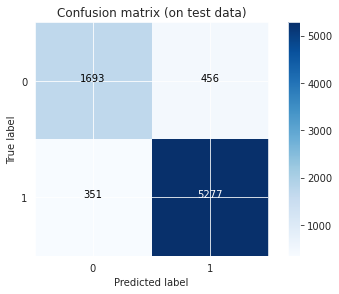

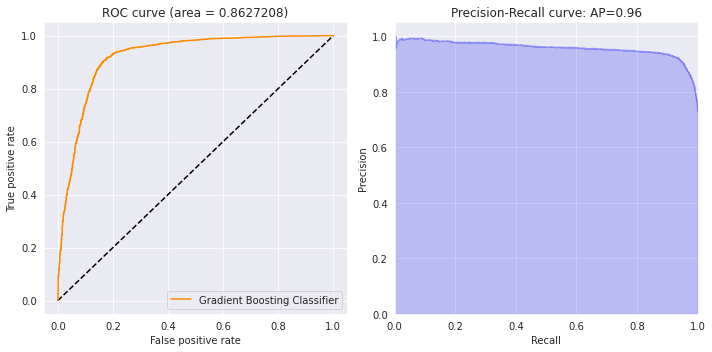

Show top 10 important features:


,feature_importance,ranking
0,,
ka_div_ks_plus1_x,0.451902,1.0
EREB_138,0.068367,2.0
Total_PFAM_x,0.056539,3.0
ka_div_ks_plus1_y,0.046826,4.0
Origin_Tandem,0.041929,5.0
Ear_E6_Repression/Activation,0.033070,6.0
dTSS_root,0.032497,7.0
dis_to_Knob,0.027081,8.0
Ks_B73_vs_sorghum,0.021819,9.0



AUC scores on testing data
Gradient Boosting Classifier auc score: 0.9201063501875055


In [102]:
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score, mean_squared_error
from sklearn.metrics import f1_score, precision_score, recall_score, log_loss, r2_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import roc_auc_score, roc_curve, classification_report
from tabulate import tabulate
import itertools
import numpy as np

folds = 5
param_comb = 5
skf = StratifiedKFold(n_splits=folds, shuffle = True, random_state = 10345)
scoring_strings = ['accuracy', 'precision', 'recall', 'f1',
                       'average_precision', 'roc_auc']
trainPerformanceData = pd.DataFrame(columns = ['Algorithm','Scoring Name','CV mean', 'CV std']) 
testPerformanceData = pd.DataFrame(columns = ['Algorithm','Accuracy','AUC','Precision','Recall','F1'])
# timing starts from this point for "start_time" variable
#start_time = timer(None)
for clf_name, clf in nonlr_clf_dict.items():
    for scoring in scoring_strings:
        scores = cross_val_score(clf, X_after_features, y_res, scoring=scoring, cv=skf,verbose=1, n_jobs=2)
        print("---------------------------------------------------------------------") 
        print(clf_name)
        print("---------------------------------------------------------------------") 
        print("Cross Validation scores on training data")
        print ('Scoring Name: CV mean: %.5f CV std: %.5f',scoring,np.mean(np.abs(scores)),np.std(scores))
        print("") 
        # append rows to an empty DataFrame 
        trainPerformanceData = trainPerformanceData.append({'Algorithm' : clf_name, 'Scoring Name' : scoring, 'CV mean' : np.mean(np.abs(scores)),'CV std' : np.std(scores)}, ignore_index = True) 
        clf.fit(X_after_features, y_res)
    y_predicted_test  = clf.predict(X_test_after_features)
    y_probabilities_test = clf.predict_proba(X_test_after_features)
    y_probabilities_success = y_probabilities_test[:, 1]

    from sklearn.metrics import average_precision_score
    average_precision = average_precision_score(y_test, y_probabilities_success)
    print('Average precision-recall score: {0:0.2f}'.format(average_precision))

    false_positive_rate, true_positive_rate, threshold = roc_curve(y_test, y_probabilities_success)

    mse        = mean_squared_error(y_test, y_predicted_test)
    logloss    = log_loss(y_test, y_predicted_test)
    accuracy   = accuracy_score(y_test, y_predicted_test)
    precision  = precision_score(y_test, y_predicted_test, average='binary')
    recall     = recall_score(y_test, y_predicted_test, average='binary')
    F1         = f1_score(y_test, y_predicted_test)
    r2         = r2_score(y_test, y_predicted_test)
    auc        = roc_auc_score(y_test, y_predicted_test)
    cm         = confusion_matrix(y_test, y_predicted_test)
    testPerformanceData = testPerformanceData.append({'Algorithm' : clf_name,'Accuracy' : accuracy,'Average_Precision':average_precision,'F1' : F1 ,'Precision' : precision,'Recall' : recall,'AUC' : auc},ignore_index = True)
    Print_Model_Metrics(clf_name)
    Plot_Confusion_Matrix(clf)
    Plot_ROC_Precision_Recall(clf_name)
#     Plot_Predictor_Importance(clf)
    importance_values = np.absolute(clf.coef_) if clf_name == 'LogisticRegression' else clf.feature_importances_
    importance_fatures_sorted = pd.DataFrame(importance_values.reshape([-1, len(feature_list[0])]), columns=feature_list[0]).mean(axis=0).sort_values(ascending=False).to_frame()
    importance_fatures_sorted.rename(columns={0: 'feature_importance'}, inplace=True)
    importance_fatures_sorted['ranking']= importance_fatures_sorted['feature_importance'].rank(ascending=False)
    importance_fatures_sorted['model'] = clf_name
    print('Show top 10 important features:')
    display(importance_fatures_sorted.drop('model', axis=1).head(50))
    auc = roc_auc_score(y_test, clf.predict_proba(X_test_after_features)[:, 1])
    print("")  
    print("AUC scores on testing data")       
    print(clf_name, 'auc score:', auc)
#timer(start_time

In [106]:
# top_25_feature = importance_fatures_sorted.drop('model', axis=1).head(50)
# top_25_feature.reset_index(inplace=True)
# top_25_feature = top_25_feature.rename(columns = {0:'feature_names'})
top_25_feature.head(25)

,feature_names,feature_importance,ranking
0,ka_div_ks_plus1_x,0.451902,1.0
1,EREB_138,0.068367,2.0
2,Total_PFAM_x,0.056539,3.0
3,ka_div_ks_plus1_y,0.046826,4.0
4,Origin_Tandem,0.041929,5.0
5,Ear_E6_Repression/Activation,0.033070,6.0
6,dTSS_root,0.032497,7.0
7,dis_to_Knob,0.027081,8.0
8,Ks_B73_vs_sorghum,0.021819,9.0
9,V5_TE,0.019732,10.0


In [111]:
trainPerformanceData

,Algorithm,Scoring Name,CV mean,CV std
0,Gradient Boosting Classifier,accuracy,0.921013,0.001379
1,Gradient Boosting Classifier,precision,0.912148,0.000941
2,Gradient Boosting Classifier,recall,0.931719,0.002895
3,Gradient Boosting Classifier,f1,0.921827,0.001486
4,Gradient Boosting Classifier,average_precision,0.959068,0.001805
5,Gradient Boosting Classifier,roc_auc,0.968500,0.001260


In [112]:
trainPerformanceData_pvt=pd.pivot_table(trainPerformanceData,index=["Algorithm"],values=["CV mean"],columns=["Scoring Name"],aggfunc=[np.min])
trainPerformanceData_pvt

amin                                        \
                               CV mean                                         
Scoring Name                  accuracy average_precision        f1 precision   
Algorithm                                                                      
Gradient Boosting Classifier  0.921013          0.959068  0.921827  0.912148   

                                                
                                                
Scoring Name                    recall roc_auc  
Algorithm                                       
Gradient Boosting Classifier  0.931719  0.9685

In [110]:
top_features = top_25_feature['feature_names'][:25]
list(top_features)
with open('top_25_features.txt', 'w') as out_f:
    for l in list(top_features):
        out_f.write(l + '\n')

In [53]:
top_features = pd.read_csv("top_25_features.txt",header = None)
x_train = X_after_features[top_features[0]]
x_test = X_test_after_features[top_features[0]]
# x_train = X_after_features[list(top_features)]
# x_test = X_test_after_features[list(top_features)]
y_train = y_res


In [116]:
# A parameter grid for Logistic Regression
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
clf = LogisticRegression()
penalty = ['l1', 'l2']
C = [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000]
#class_weight = [{1:0.5, 0:0.5}, {1:0.4, 0:0.6}, {1:0.6, 0:0.4}, {1:0.7, 0:0.3}]
solver = ['liblinear', 'saga']

param_grid = dict(penalty=penalty,
                  C=C,
                  #class_weight=class_weight,
                  solver=solver)

In [120]:
model = GridSearchCV(estimator=clf, param_grid=param_grid, scoring='roc_auc', n_jobs=4, cv=skf.split(x_train,y_train), verbose=3)

# Here we go
#start_time = timer(None) # timing starts from this point for "start_time" variable
model.fit(x_train, y_train)
#timer(start_time) # timing ends here for "start_time" variable
best_model = best_mdl()

Fitting 5 folds for each of 32 candidates, totalling 160 fits

 Best estimator:
LogisticRegression(C=0.1, solver='saga')

 Best score:
0.7877662151635652

 Best parameters:
{'C': 0.1, 'penalty': 'l2', 'solver': 'saga'}

 CV results:
   mean_fit_time  std_fit_time  mean_score_time  std_score_time param_C  \
0       0.051369      0.006450         0.006957        0.001742  0.0001   
1       0.128930      0.021781         0.009168        0.003555  0.0001   
2       0.117399      0.024478         0.007571        0.002040  0.0001   
3       0.246279      0.029114         0.006369        0.001510  0.0001   
4       0.144575      0.020974         0.009288        0.003734   0.001   

  param_penalty param_solver  \
0            l1    liblinear   
1            l1         saga   
2            l2    liblinear   
3            l2         saga   
4            l1    liblinear   

                                              params  split0_test_score  \
0  {'C': 0.0001, 'penalty': 'l1', 'solver': 'lib

AttributeError: 'DataFrame' object has no attribute 'best_estimator_'

In [54]:
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
models1 = {
    'Logistic Regression' : LogisticRegression(),
    'RandomForestClassifier': RandomForestClassifier(),
    'GradientBoostingClassifier': GradientBoostingClassifier(),
    'ExtraTreesClassifier': ExtraTreesClassifier(),
    'KNeighbors Classifier' : KNeighborsClassifier(),   
    'SVC': SVC()
}
params1 = {
 'Logistic Regression' : {'penalty' : ['l1','l2'], 'C' : np.logspace(0, 4, 10), 'solver' :['liblinear']},
 'RandomForestClassifier': { 'n_estimators': [16, 32] },
 'GradientBoostingClassifier': { 'n_estimators': [16, 32], 'learning_rate': [0.8, 1.0] },
 'ExtraTreesClassifier': { 'n_estimators': [16, 32] },
 'KNeighbors Classifier' : {'n_neighbors' :[1,2,5,6,7,10], 'weights':['uniform', 'distance']}, 
 'SVC': {'kernel': ['linear','rbf'], 'C': [1, 10], 'gamma': [0.001, 0.0001]} 
}

In [55]:
import pandas as pd
import numpy as np
from sklearn.model_selection import RandomizedSearchCV

class EstimatorSelectionHelper:

    def __init__(self, models, params):
        if not set(models.keys()).issubset(set(params.keys())):
            missing_params = list(set(models.keys()) - set(params.keys()))
            raise ValueError("Some estimators are missing parameters: %s" % missing_params)
        self.models = models
        self.params = params
        self.keys = models.keys()
        self.grid_searches = {}

    def fit(self, X, y, cv=5, n_jobs=3, verbose=1, scoring=None, refit=False):
        for key in self.keys:
            print("Running RandomizedSearchCV for %s." % key)
            model = self.models[key]
            params = self.params[key]
            gs = RandomizedSearchCV(estimator= model, param_distributions = params, cv=cv, n_jobs=n_jobs,
                              verbose=verbose, scoring=scoring, random_state = 2020)
            gs.fit(X,y)
            print('=====================================================================')
            print('Best Score: %s' % gs.fit(X,y).best_score_)
            print('Best Hyperparameters: %s' % gs.fit(X,y).best_params_)
            print('=====================================================================')
            self.grid_searches[key] = gs 
            
    def score_summary(self, sort_by='mean_score'):
        def row(key, scores, params):
            d = {
                 'estimator': key,
                 'min_score': min(scores),
                 'max_score': max(scores),
                 'mean_score': np.mean(scores),
                 'std_score': np.std(scores),
            }
            return pd.Series({**params,**d})

        rows = []
        for k in self.grid_searches:
            print(k)
            params = self.grid_searches[k].cv_results_['params']
            scores = []
            for i in range(self.grid_searches[k].cv):
                key = "split{}_test_score".format(i)
                r = self.grid_searches[k].cv_results_[key]        
                scores.append(r.reshape(len(params),1))

            all_scores = np.hstack(scores)
            for p, s in zip(params,all_scores):
                rows.append((row(k, s, p)))

        df = pd.concat(rows, axis=1).T.sort_values([sort_by], ascending=False)

        columns = ['estimator', 'min_score', 'mean_score', 'max_score', 'std_score']
        columns = columns + [c for c in df.columns if c not in columns]

        return df[columns]


In [56]:
# Define the scoring 
scoring_strings = ['accuracy', 'precision', 'recall', 'f1', 'average_precision','roc_auc']
scores_all = pd.DataFrame() 
# Create object of the class helper
helper1 = EstimatorSelectionHelper(models1, params1)
flag=True
for scoring in scoring_strings:
    helper1.fit(x_train, y_train, cv=5, scoring=scoring, n_jobs=2)
    df_scores = helper1.score_summary(sort_by='max_score')
    if flag: 
       # Saving each model for each scoring. Plz change with ur path
        df_scores.to_csv(scoring+".csv")
        df_scores['scoring_name']=scoring
        scores_all = df_scores
        print(scoring)
        print(scores_all)
        flag=False
    else:
# Saving each model for each scoring. Plz change with ur path
        df_scores.to_csv(scoring+".csv")
        df_scores['scoring_name']=scoring
        scores_all= scores_all.append(df_scores, ignore_index=True, sort=False)
        print(scoring)
        print(scores_all)
        
# Saving each model for each scoring. Plz change with ur path
scores_all.to_csv("scores_all.csv")

Running RandomizedSearchCV for Logistic Regression.
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best Score: 0.8318747223456242
Fitting 5 folds for each of 10 candidates, totalling 50 fits
Best Hyperparameters: {'solver': 'liblinear', 'penalty': 'l2', 'C': 1.0}
Running RandomizedSearchCV for RandomForestClassifier.
Fitting 5 folds for each of 2 candidates, totalling 10 fits
Fitting 5 folds for each of 2 candidates, totalling 10 fits
Best Score: 0.9141270546423812
Fitting 5 folds for each of 2 candidates, totalling 10 fits
Best Hyperparameters: {'n_estimators': 32}
Running RandomizedSearchCV for GradientBoostingClassifier.
Fitting 5 folds for each of 4 candidates, totalling 20 fits
Fitting 5 folds for each of 4 candidates, totalling 20 fits
Best Score: 0.9132385606397155
Fitting 5 folds for each of 4 candidates, totalling 20 fits
Best Hyperparameters: {'n_estimators': 32, 'learning_rate': 0.8}
Running Randomize

In [ ]:
scores_all.sort_values(by=['mean_score'],ascending=False)

,estimator,min_score,mean_score,max_score,std_score,solver,penalty,C,n_estimators,learning_rate,weights,n_neighbors,kernel,gamma,scoring_name
181,GradientBoostingClassifier,0.914603,0.964931,0.994981,0.036251,NaN,NaN,NaN,32,0.8,NaN,NaN,NaN,NaN,roc_auc
183,RandomForestClassifier,0.916904,0.964422,0.993324,0.034984,NaN,NaN,NaN,32,NaN,NaN,NaN,NaN,NaN,roc_auc
180,GradientBoostingClassifier,0.909494,0.96341,0.995271,0.038301,NaN,NaN,NaN,32,1.0,NaN,NaN,NaN,NaN,roc_auc
186,ExtraTreesClassifier,0.918692,0.963377,0.990441,0.032934,NaN,NaN,NaN,32,NaN,NaN,NaN,NaN,NaN,roc_auc
182,GradientBoostingClassifier,0.907948,0.961198,0.994012,0.038934,NaN,NaN,NaN,16,0.8,NaN,NaN,NaN,NaN,roc_auc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70,SVC,0.782519,0.816745,0.840645,0.025967,NaN,NaN,10,NaN,NaN,NaN,NaN,linear,0.0001,precision
69,SVC,0.782519,0.816745,0.840645,0.025967,NaN,NaN,10,NaN,NaN,NaN,NaN,linear,0.001,precision
35,SVC,0.809529,0.814705,0.818858,0.003045,NaN,NaN,1,NaN,NaN,NaN,NaN,rbf,0.0001,accuracy
71,SVC,0.800647,0.804992,0.810198,0.003479,NaN,NaN,1,NaN,NaN,NaN,NaN,rbf,0.0001,precision


In [ ]:
output_random = pd.pivot_table(scores_all,index=["estimator"],values=["mean_score"],columns=["scoring_name"],
                              aggfunc=[np.max])

In [ ]:
output_random['amax']['mean_score'].sort_values(by='roc_auc',ascending=False)

scoring_name,accuracy,average_precision,f1,precision,recall,roc_auc
estimator,,,,,,
GradientBoostingClassifier,0.913194,0.954604,0.917670,0.910833,0.931497,0.964931
RandomForestClassifier,0.912394,0.953738,0.917295,0.908206,0.935940,0.964422
ExtraTreesClassifier,0.916304,0.954708,0.920953,0.916002,0.932830,0.963377
KNeighbors Classifier,0.881830,0.935029,0.880769,0.938603,0.869169,0.942038
SVC,0.842315,0.889994,0.847293,0.825446,0.872279,0.906972
Logistic Regression,0.831875,0.875496,0.833269,0.828069,0.839094,0.891005


In [130]:
params1 = {
 'Logistic Regression' : {'penalty' : ['l1','l2'], 'C' : np.logspace(0, 4, 10), 'solver' :['liblinear']},
 'RandomForestClassifier': { 'n_estimators': [16, 32] },
 'GradientBoostingClassifier': { 'n_estimators': [16, 32], 'learning_rate': [0.8, 1.0] },
 'ExtraTreesClassifier': { 'n_estimators': [16, 32] },
 'KNeighbors Classifier' : {'n_neighbors' :[1,2,5,6,7,10], 'weights':['uniform', 'distance']}, 
 'SVC': {'kernel': ['linear','rbf'], 'C': [1, 10], 'gamma': [0.001, 0.0001]} 
}

In [133]:
import pandas as pd
import numpy as np
from sklearn.model_selection import GridSearchCV

class EstimatorSelectionHelper:

    def __init__(self, models, params):
        if not set(models.keys()).issubset(set(params.keys())):
            missing_params = list(set(models.keys()) - set(params.keys()))
            raise ValueError("Some estimators are missing parameters: %s" % missing_params)
        self.models = models
        self.params = params
        self.keys = models.keys()
        self.grid_searches = {}

    def fit(self, X, y, cv=5, n_jobs=3, verbose=1, scoring=None, refit=False):
        for key in self.keys:
            print("Running RandomizedSearchCV for %s." % key)
            model = self.models[key]
            params = self.params[key]
            gs = GridSearchCV(model, params, cv=cv, n_jobs=n_jobs,
                 verbose=verbose, scoring=scoring, refit=refit,
                 return_train_score=True)
            gs.fit(X,y)
            print('=====================================================================')
            print('Best Score: %s' % gs.fit(X,y).best_score_)
            print('Best Hyperparameters: %s' % gs.fit(X,y).best_params_)
            print('=====================================================================')
            self.grid_searches[key] = gs 
            
    def score_summary(self, sort_by='mean_score'):
        def row(key, scores, params):
            d = {
                 'estimator': key,
                 'min_score': min(scores),
                 'max_score': max(scores),
                 'mean_score': np.mean(scores),
                 'std_score': np.std(scores),
            }
            return pd.Series({**params,**d})

        rows = []
        for k in self.grid_searches:
            print(k)
            params = self.grid_searches[k].cv_results_['params']
            scores = []
            for i in range(self.grid_searches[k].cv):
                key = "split{}_test_score".format(i)
                r = self.grid_searches[k].cv_results_[key]        
                scores.append(r.reshape(len(params),1))

            all_scores = np.hstack(scores)
            for p, s in zip(params,all_scores):
                rows.append((row(k, s, p)))

        df = pd.concat(rows, axis=1).T.sort_values([sort_by], ascending=False)

        columns = ['estimator', 'min_score', 'mean_score', 'max_score', 'std_score']
        columns = columns + [c for c in df.columns if c not in columns]

        return df[columns]


In [135]:
scores_all.sort_values(by=['mean_score'],ascending=False)

,estimator,min_score,mean_score,max_score,std_score,C,penalty,solver,n_estimators,learning_rate,n_neighbors,weights,gamma,kernel,scoring_name
241,GradientBoostingClassifier,0.91466,0.964915,0.995075,0.036336,NaN,NaN,NaN,32,0.8,NaN,NaN,NaN,NaN,roc_auc
244,RandomForestClassifier,0.915639,0.963835,0.992924,0.035223,NaN,NaN,NaN,32,NaN,NaN,NaN,NaN,NaN,roc_auc
240,GradientBoostingClassifier,0.909494,0.963423,0.995274,0.038311,NaN,NaN,NaN,32,1.0,NaN,NaN,NaN,NaN,roc_auc
246,ExtraTreesClassifier,0.917188,0.96309,0.990277,0.033084,NaN,NaN,NaN,32,NaN,NaN,NaN,NaN,NaN,roc_auc
242,GradientBoostingClassifier,0.907948,0.961198,0.994012,0.038934,NaN,NaN,NaN,16,0.8,NaN,NaN,NaN,NaN,roc_auc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,SVC,0.782519,0.816745,0.840645,0.025967,10,NaN,NaN,NaN,NaN,NaN,NaN,0.001,linear,precision
94,SVC,0.782519,0.816745,0.840645,0.025967,10,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,linear,precision
47,SVC,0.809529,0.814705,0.818858,0.003045,1,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,rbf,accuracy
95,SVC,0.800647,0.804992,0.810198,0.003479,1,NaN,NaN,NaN,NaN,NaN,NaN,0.0001,rbf,precision


In [136]:
output_grid = pd.pivot_table(scores_all,index=["estimator"],values=["mean_score"],columns=["scoring_name"],
                              aggfunc=[np.max])

In [137]:
output_grid['amax']['mean_score'].sort_values(by='roc_auc',ascending=False)

scoring_name,accuracy,average_precision,f1,precision,recall,roc_auc
estimator,,,,,,
GradientBoostingClassifier,0.913216,0.954687,0.917718,0.910833,0.931453,0.964915
RandomForestClassifier,0.912239,0.952570,0.916820,0.907177,0.936162,0.963835
ExtraTreesClassifier,0.916681,0.953749,0.921538,0.916673,0.933629,0.963090
KNeighbors Classifier,0.881830,0.935029,0.880769,0.938603,0.869169,0.942038
SVC,0.842315,0.889994,0.847293,0.825446,0.872279,0.906972
Logistic Regression,0.831875,0.875499,0.833269,0.828069,0.839094,0.891005


In [91]:
pip install -v scikit-learn==0.24.2

Using pip 21.3.1 from /home/shatabdi.sen/.local/lib/python3.9/site-packages/pip (python 3.9)
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


test :  [[ 0.33239668  4.22802371  0.66084836 ... -0.56843472  0.37653208
   3.73527297]
 [ 0.31619159 -0.05750782  0.66084836 ...  0.89839471 -0.79525686
  -0.84157861]
 [-0.65014935 -0.91461413 -1.51320645 ...  0.89839471 -0.79525686
  -0.84157861]
 ...
 [-0.65014935  0.79959848  0.66084836 ...  0.89839471  0.37653208
  -0.07877001]
 [ 0.36996787  2.5138111   0.66084836 ...  0.89839471  0.37653208
  -0.07877001]
 [ 0.29031499  0.79959848  0.66084836 ... -0.56843472  1.54832102
  -0.84157861]]
Average precision-recall score: 0.96
╒════════════════════════╤═══════════════════════╕
│ Metric                 │   Testing Performance │
╞════════════════════════╪═══════════════════════╡
│ accuracy               │              0.88736  │
├────────────────────────┼───────────────────────┤
│ precision              │              0.918546 │
├────────────────────────┼───────────────────────┤
│ recall                 │              0.927626 │
├────────────────────────┼───────────────────────┤
│ mi

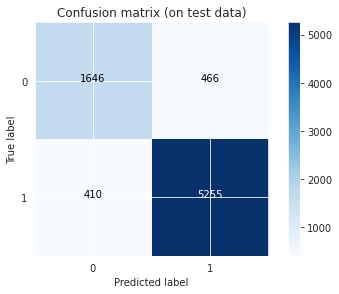

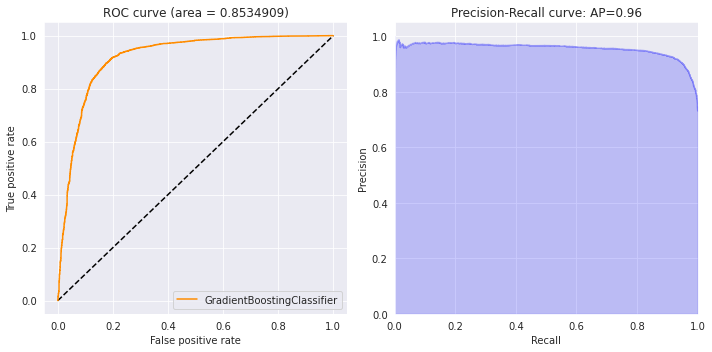


AUC scores on testing data
GradientBoostingClassifier auc score: 0.9181531499906389
Confusion Matrix : 

 [[1646  410]
 [ 466 5255]]
Classification Report : 

               precision    recall  f1-score   support

           0       0.78      0.80      0.79      2056
           1       0.93      0.92      0.92      5721

    accuracy                           0.89      7777
   macro avg       0.85      0.86      0.86      7777
weighted avg       0.89      0.89      0.89      7777
 

GradientBoostingClassifier(learning_rate=0.8, n_estimators=32)


In [81]:
### Import Libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import pickle
from sklearn.metrics import roc_auc_score, roc_curve, classification_report
from sklearn.metrics import confusion_matrix, accuracy_score, mean_squared_error
from sklearn.metrics import f1_score, precision_score, recall_score, log_loss, r2_score
from sklearn.metrics import precision_recall_curve
from tabulate import tabulate
import itertools

warnings.filterwarnings('ignore')

feature_list = pd.read_csv("top_25_features.txt",header=None)

Core_X = core_2.drop('core_label', axis=1)  

X = Core_X[feature_list[0]]
y = core_2['core_label'] 
cat_col = ['ID','classical_label','core_label','Origin','Subcel1','Subcel2','Subcel3','Subcel4','Subcel5','Localization','Type','chromosome']
num_col = [ele for ele in X.columns if ele not in cat_col]
len(num_col)

from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state=0)
x_train = x_train.fillna(0)
x_test = x_test.fillna(0)

#### Data Preprocessing

from sklearn.preprocessing import StandardScaler
testPerformanceData = pd.DataFrame(columns = ['Algorithm','Accuracy','AUC','Precision','Recall','F1'])
clf_name = "GradientBoostingClassifier"
scaler = StandardScaler()

x_train[num_col] = scaler.fit_transform(x_train[num_col])
x_test = scaler.transform(x_test)
print("test : " , x_test)

sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(x_train, y_train)

# print(X_res.head())
##
from sklearn.ensemble import GradientBoostingClassifier
clf_gb = GradientBoostingClassifier(n_estimators = 32, learning_rate = 0.8)
clf_gb.fit(X_res, y_res)
predictions = clf_gb.predict(x_test)
y_probabilities_test = clf_gb.predict_proba(x_test)
y_probabilities_success = y_probabilities_test[:, 1]

from sklearn.metrics import average_precision_score
average_precision = average_precision_score(y_test, y_probabilities_success)
print('Average precision-recall score: {0:0.2f}'.format(average_precision))

false_positive_rate, true_positive_rate, threshold = roc_curve(y_test, y_probabilities_success)

mse        = mean_squared_error(y_test, predictions)
logloss    = log_loss(y_test, predictions)
accuracy   = accuracy_score(y_test, predictions)
precision  = precision_score(y_test, predictions, average='binary')
recall     = recall_score(y_test, predictions, average='binary')
F1         = f1_score(y_test, predictions)
r2         = r2_score(y_test, predictions)
auc        = roc_auc_score(y_test, predictions)
cm         = confusion_matrix(y_test, predictions)
testPerformanceData = testPerformanceData.append({'Algorithm' : clf_name,'Accuracy' : accuracy,'Average_Precision':average_precision,'F1' : F1 ,'Precision' : precision,'Recall' : recall,'AUC' : auc},ignore_index = True)
Print_Model_Metrics("GradientBoostingClassifier")
Plot_Confusion_Matrix(clf_gb)
Plot_ROC_Precision_Recall("GradientBoostingClassifier")
auc = roc_auc_score(y_test, clf_gb.predict_proba(x_test)[:, 1])
print("")  
print("AUC scores on testing data")       
print("GradientBoostingClassifier", 'auc score:', auc)

from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

print("Confusion Matrix : \n\n" , confusion_matrix(predictions,y_test))

print("Classification Report : \n\n" , classification_report(predictions,y_test),"\n")


pickle.dump(clf_gb, open('model.pkl', 'wb'))
pickle.dump(scaler, open('scaler.pkl', 'wb'))

model = pickle.load(open('model.pkl', 'rb'))
print(model)

In [82]:
# Extra_test_new.head(1)
load_model = pickle.load(open("model.pkl", 'rb'))
lst = [0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 39027891.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 18.0, 96970958.0, 0.0, 0.0, 0.0, 0.0]
arr = np.array(lst).reshape(1,-1)
X_unseenData = scaler.transform(arr)
print(X_unseenData.dtype)
result = load_model.predict(X_unseenData)
print(result)

float64
[0]


In [92]:
sklearn_version = sklearn.__version__
print(sklearn_version)

<IPython.core.display.Javascript object>

1.0.2
